## Initial Imports

In [1]:
## Start extract-figures.py code

import argparse
import json
import os
import sys

import cv2
import numpy

from image_mining.figure_extraction import FigureExtractor
from image_mining.utils import open_image

In [2]:
import numpy as np
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

%matplotlib inline
sns.set()

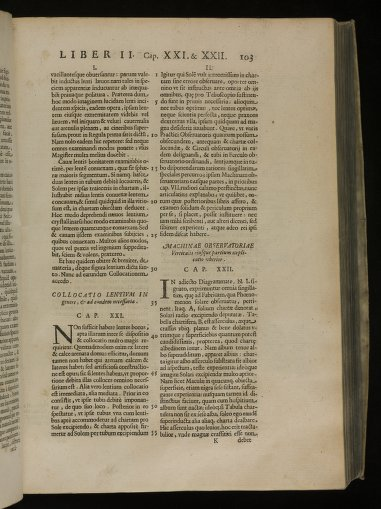

In [3]:
from IPython.display import Image, display
from IPython.core.display import HTML

PATH = "/home/eth/lorisal/lorisal/data/ouhsc/Rosa Vrsina/3/3254bbbb-c156-5e7c-adf8-15a7c7f9363c.jpg"
display(Image(filename = PATH, width=100, height=100))

## Build List of Books and Images

In [8]:
from collections import namedtuple

Book = namedtuple('Book', 'name dir files imagelist')

books = []

books_path = "/home/eth/lorisal/test_data/"

# for (dirpath, dirnames, filenames) in os.walk(books_path):
#     for dirs in dirnames:
#         books.append(Book())
#         print(dirs)

for name in os.listdir(books_path):
    books.append( Book( 
        name,
        books_path + name + '/',
        [files for files in os.listdir(books_path + '/' + name + '/10/')],
        [files for files in os.listdir(books_path + '/' + name + '/withImages/')]))


for book in books:
    print( book.name )

The First Six Books of Euclid in which Colored Diagrams and Symbols are used instead of Letters for the greater ease of Learners
Opera
The history of fourfooted beasts and serpents
Theory of the Earth
Atlas coelestis
The Natural History of Human Teeth
Harmonices mvndi
Perspectiva
The Systeme of the World in Four Dialogues in Thomas Salusbury Mathematical Discourses 1661
Discorso delle comete di mario Gvidvcci...
Micrographia
Rosa Vrsina
Two anatomical exercitations concerning the circulation of the blood
Libra astronomica ac philosophica qua Galilaei Galilaei opiniones de cometis a Mario Guiducio...
Kritischer Kommentar über die östreichische Provinzialpharmakopee Pharmacopœa AustriacoProvincialis
The Chronology of Ancient Kingdoms Amended
De furtivis literarum notis vulgo
Sopra il turbine
General History of China Volume 2


[Book(name='The First Six Books of Euclid in which Colored Diagrams and Symbols are used instead of Letters for the greater ease of Learners', dir='/home/eth/lorisal/test_data/The First Six Books of Euclid in which Colored Diagrams and Symbols are used instead of Letters for the greater ease of Learners/', files=['5eb51127-83ab-5b17-b1a0-3b9e28294a9b.jpg', '696131c6-a5ba-5cdc-8932-8262ed89761d.jpg', '73b65754-fc30-5ac9-8ef1-4997710cd5df.jpg', 'be80f079-13ef-55cc-be55-13ba0fb9d785.jpg', 'acc97bce-1adf-5eea-928e-0487253a99e6.jpg', '09f36b51-c6fb-5c02-9918-8fcf24410367.jpg', '643c6c53-153c-5ded-9a9a-00223bcd920e.jpg', '1735d215-424c-563b-90df-eb3d9ac4c28a.jpg', '86572854-739c-5bd8-8743-29faffd9f01c.jpg', '22b2df8a-5c66-59a0-a5ce-2e157a07c66c.jpg', 'd5f68a73-ee60-54af-9248-e422c9a4c653.jpg', '3ad6582e-69f5-50c7-bed4-b03c604ed5fe.jpg', 'fa5e15f3-980b-535e-b9b5-e105efa367f2.jpg', '0ccaa1e2-7694-546f-91b5-55b6a234f9d2.jpg', '77cdb91c-80e1-547c-8f43-ffc3482f456a.jpg', '7cfb83ff-850c-5318-85e0-

## Caclulate Recall and Precision across range of erosion and dilaion sizes

In [5]:
def imageExtractionTest( book, erosion_size, dilation_size):
    params = {
        "canny_threshold": 0, # No Luck Setting this at 1 or above
        "erosion_element": "rectangle",
        "erosion_size": erosion_size, # Larger triggers more images
        "dilation_element": "rectangle",
        "dilation_size": dilation_size, # Smaller Triggers more images
    }
    
    extractor = FigureExtractor(**params)
    
    images_found = []
    
    for f in book.files:
        try:
            base_name, source_image = open_image(book.dir + '10/' + f)
        except:
            print("Open Error for %s"%(f))
            continue
        
        for fig in extractor.find_figures(source_image):
            if f not in images_found:
                images_found.append(f)
    
    tp = len( set(book.imagelist).intersection(images_found) )
    if tp > 0:
        fp = len( [item for item in images_found if item not in book.imagelist] )
    else:
        fp = 1
        
    recall_score = tp / len(book.imagelist)
    precision_score = tp / (tp + fp)
    
    return (erosion_size, dilation_size, recall_score, precision_score)

In [ ]:
books_recall = {}
books_precision = {}

for book in books:
    
    print(book.name)
    book_recall = []
    book_precision = []
    for erosion in range(9,12):
        recall_row = []
        precision_row = []
        for dilation in range(0,2):
            data = imageExtractionTest(book,erosion,dilation)
            recall_row.append( data[2] )
            precision_row.append( data[3] )
        book_recall.append(recall_row)
        book_precision.append(precision_row)
        print( "Finished: " + str(erosion) + ", " + str(dilation) )
        
    books_recall[book.name] = pd.DataFrame(book_recall)
    books_precision[book.name] = pd.DataFrame(book_precision)

The First Six Books of Euclid in which Colored Diagrams and Symbols are used instead of Letters for the greater ease of Learners
Open Error for a4e1d7e6-10b9-55c1-ab2f-db43c8b1cd2a.jpg
Open Error for a3276a71-ccc3-53e8-a67b-31f7becc21ac.jpg


## Recall for each model by erosion and dilation

In [201]:
plt.rcParams['figure.figsize'] = (20.0, 60.0)

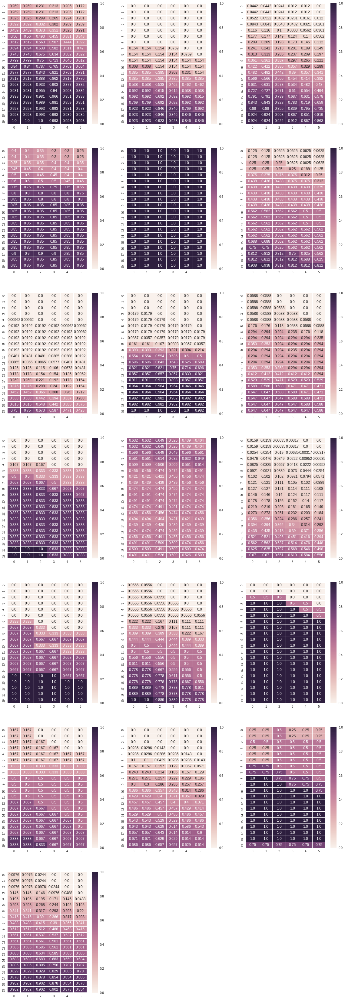

In [202]:
for i, book in enumerate(books, 1):
    plt.subplot(7,3,i)
    sns.heatmap(books_recall[book.name], annot=True, fmt=".3", linewidths=.5, vmin=0.0, vmax=1.0)

## Using F-Score, showing Recall, F2, F3 and F4 for each book
### Motivation here is the getting all pages with images is more important than grabbing a few extra

In [203]:
plt.rcParams['figure.figsize'] = (20.0, 180.0)

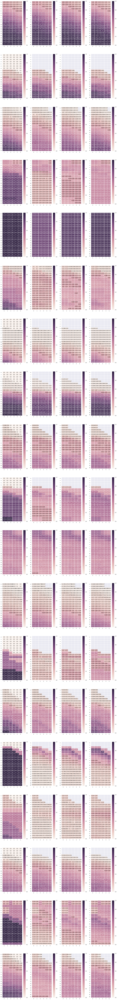

In [204]:
for i, book in enumerate(books, 1):
    r = books_recall[book.name]
    p = books_precision[book.name]
    plt.subplot(19,4, i*4-3 )
    sns.heatmap( r , annot=True, fmt=".3", linewidths=.5, vmin=0.0, vmax=1.0)
    
    plt.subplot(19,4, i*4-2 )
    beta = 2
    sns.heatmap( (1 + beta * beta) * (p*r)/(beta*beta * p+r), annot=True, fmt=".3", linewidths=.5, vmin=0.0, vmax=1.0)
    
    plt.subplot(19,4, i*4-1 )
    beta = 3
    sns.heatmap( (1 + beta * beta) * (p*r)/(beta*beta * p+r), annot=True, fmt=".3", linewidths=.5, vmin=0.0, vmax=1.0)
    
    plt.subplot(19,4, i*4-0 )
    beta = 4
    sns.heatmap( (1 + beta * beta) * (p*r)/(beta*beta * p+r), annot=True, fmt=".3", linewidths=.5, vmin=0.0, vmax=1.0)

## Using "Best" Erosion and Dilation for each book, review success

In [188]:
def getMissingExtraction(book, book_recall, book_precision, beta):
    f2 = (1 + beta * beta) * ( (book_recall * book_precision) / (beta * beta * book_precision + book_recall) )
    f2_max = f2.idxmax()
    f2_maxval = f2.max()
    
    maxs = f2_maxval[ f2_maxval == f2_maxval.max() ].index
    
    dilation_size = max( list( maxs ) )
    erosion_size = f2_max[dilation_size]
    
    print( book.name + " -- Dilation: " + str(dilation_size) + " Erosion: " + str(erosion_size) )
    
    params = {
        "canny_threshold": 0, # No Luck Setting this at 1 or above
        "erosion_element": "rectangle",
        "erosion_size": erosion_size, # Larger triggers more images
        "dilation_element": "rectangle",
        "dilation_size": dilation_size, # Smaller Triggers more images
    }
    
    extractor = FigureExtractor(**params)
    
    images_found = []
    
    for f in book.files:
        try:
            base_name, source_image = open_image(book.dir + '3/' + f)
        except:
            print("Open Error for %s"%(f))
            continue
        
        for fig in extractor.find_figures(source_image):
            if f not in images_found:
                images_found.append(f)
    
    extras = [item for item in images_found if item not in book.imagelist] 
    missing = [item for item in book.imagelist if item not in images_found] 
        
    return (missing, extras)

In [259]:
betas = [1,2,3,4]
book_betas = []

for book in books:
    title = book.name
    beta_results = {}
    for beta in betas:
        print( "Beta: " + str(beta) )
        missing, extras = getMissingExtraction(book, books_recall[title], books_precision[title], beta )
        print(str(len(missing)) + " missing images")
        print(str(len(extras)) + " extra images")
        print(str(len(book.files)) + " total pages")
        beta_results[beta] = [ len(missing), len(extras), len(book.files) ]
    book_betas.append( pd.DataFrame(beta_results) )

Beta: 1
The First Six Books of Euclid in which Colored Diagrams and Symbols are used instead of Letters for the greater ease of Learners -- Dilation: 2 Erosion: 19
0 missing images
45 extra images
313 total pages
Beta: 2
The First Six Books of Euclid in which Colored Diagrams and Symbols are used instead of Letters for the greater ease of Learners -- Dilation: 2 Erosion: 19
0 missing images
45 extra images
313 total pages
Beta: 3
The First Six Books of Euclid in which Colored Diagrams and Symbols are used instead of Letters for the greater ease of Learners -- Dilation: 2 Erosion: 19
0 missing images
45 extra images
313 total pages
Beta: 4
The First Six Books of Euclid in which Colored Diagrams and Symbols are used instead of Letters for the greater ease of Learners -- Dilation: 2 Erosion: 19
0 missing images
45 extra images
313 total pages
Beta: 1
Opera -- Dilation: 3 Erosion: 19
	Merging overlapping extracts: (73, 101)-(506, 376) (82, 375)-(511, 562)
	Merging overlapping extracts: (94

In [260]:
for df in book_betas:
    df.index = pd.Index(["Missing", "Extra", "Total"])
    
booknames = [book.name for book in books]
result = pd.concat(book_betas, keys=booknames)

result
# g = sns.factorplot(x = "beta", y = "number of pages", hue="identifier", data=df, size=6, kind="bar")

1     2     3  \
The First Six Books of Euclid in which Colored ... Missing     0     0     0   
                                                   Extra      45    45    45   
                                                   Total     313   313   313   
Opera                                              Missing     1     1     1   
                                                   Extra       2     2     2   
                                                   Total      21    21    21   
The history of fourfooted beasts and serpents      Missing    70    23    19   
                                                   Extra     367   606   648   
                                                   Total    1108  1108  1108   
Theory of the Earth                                Missing    11    10    10   
                                                   Extra       2     5     5   
                                                   Total     361   361   361   
Atlas coelestis                                    Missing     0     0     0   
                                                   Extra      38    38    38   
                                                   Total      72    72    72   
The Natural History of Human Teeth                 Missing     9     9     3   
                                                   Extra      39    39   144   
                                                   Total     334   334   334   
Harmonices mvndi                                   Missing    34    26    26   
                                                   Extra     167   199   199   
                                                   Total     427   427   427   
Perspectiva                                        Missing     0     0     0   
                                                   Extra      38    38    38   
                                                   Total     109   109   109   
The Systeme of the World in Four Dialogues in T... Missing     6     6     6   
                                                   Extra      15    15    15   
                                                   Total     176   176   176   
Discorso delle comete di mario Gvidvcci...         Missing     3     2     1   
                                                   Extra       3     7    18   
                                                   Total      69    69    69   
Micrographia                                       Missing    20    20    20   
                                                   Extra       5     5     5   
                                                   Total     709   709   709   
Rosa Vrsina                                        Missing   143   104   104   
                                                   Extra      89   205   205   
                                                   Total     917   917   917   
Two anatomical exercitations concerning the cir... Missing     1     1     1   
                                                   Extra      27    27    27   
                                                   Total      95    95    95   
Libra astronomica ac philosophica qua Galilaei ... Missing    12     0     0   
                                                   Extra       2    62    62   
                                                   Total      81    81    81   
Kritischer Kommentar über die östreichische Pro... Missing     0     0     0   
                                                   Extra       6     6     6   
                                                   Total     329   329   329   
The Chronology of Ancient Kingdoms Amended         Missing     3     3     3   
                                                   Extra      61    61    61   
                                                   Total     413   413   413   
De furtivis literarum notis vulgo                  Missing    26    24    22   
                                                   Extra      1

Beta: 4
The First Six Books of Euclid in which Colored Diagrams and Symbols are used instead of Letters for the greater ease of Learners -- Dilation: 2 Erosion: 19
0 missing images
45 extra images
313 total pages
Missing:
Opera -- Dilation: 3 Erosion: 19
	Merging overlapping extracts: (73, 101)-(506, 376) (82, 375)-(511, 562)
	Merging overlapping extracts: (94, 559)-(523, 811) (73, 101)-(511, 562)
1 missing images
2 extra images
21 total pages
Missing:


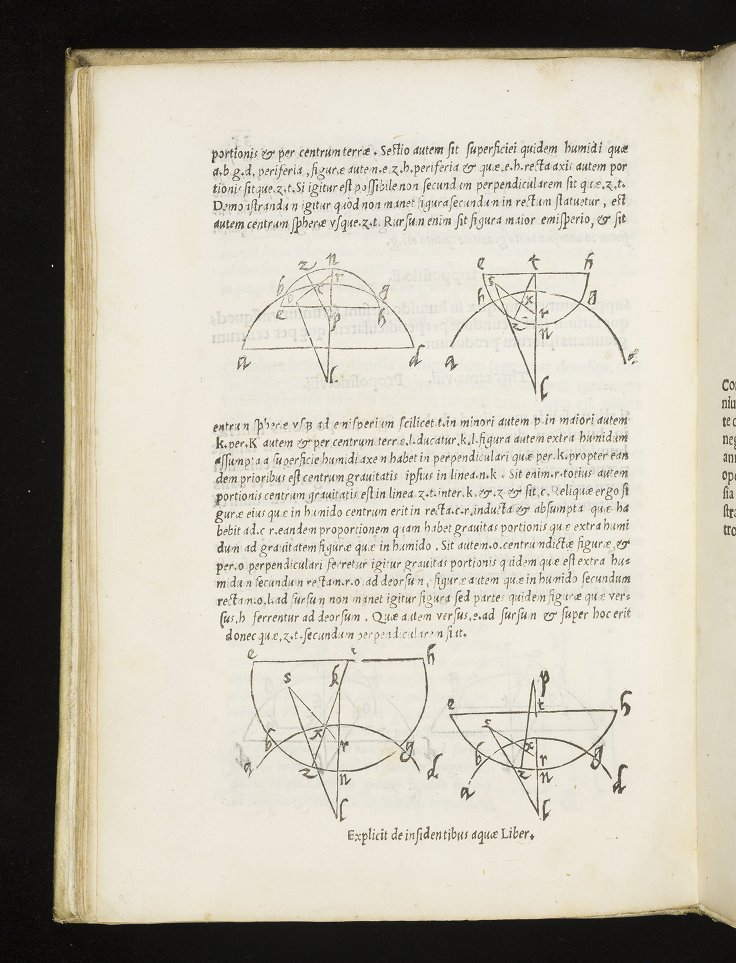

Extras:


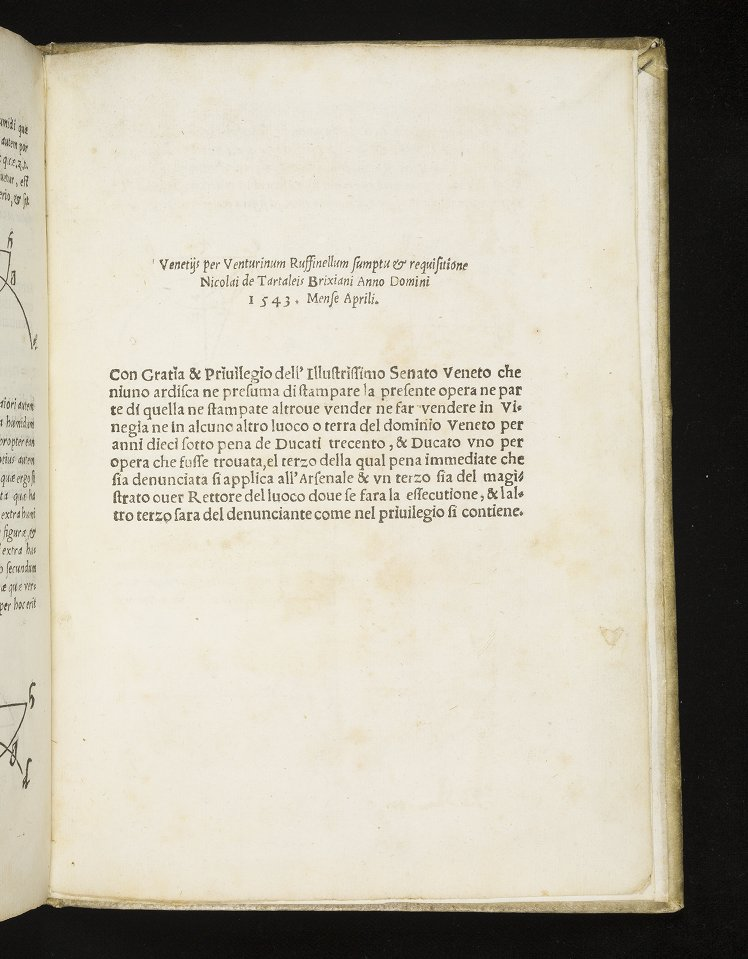

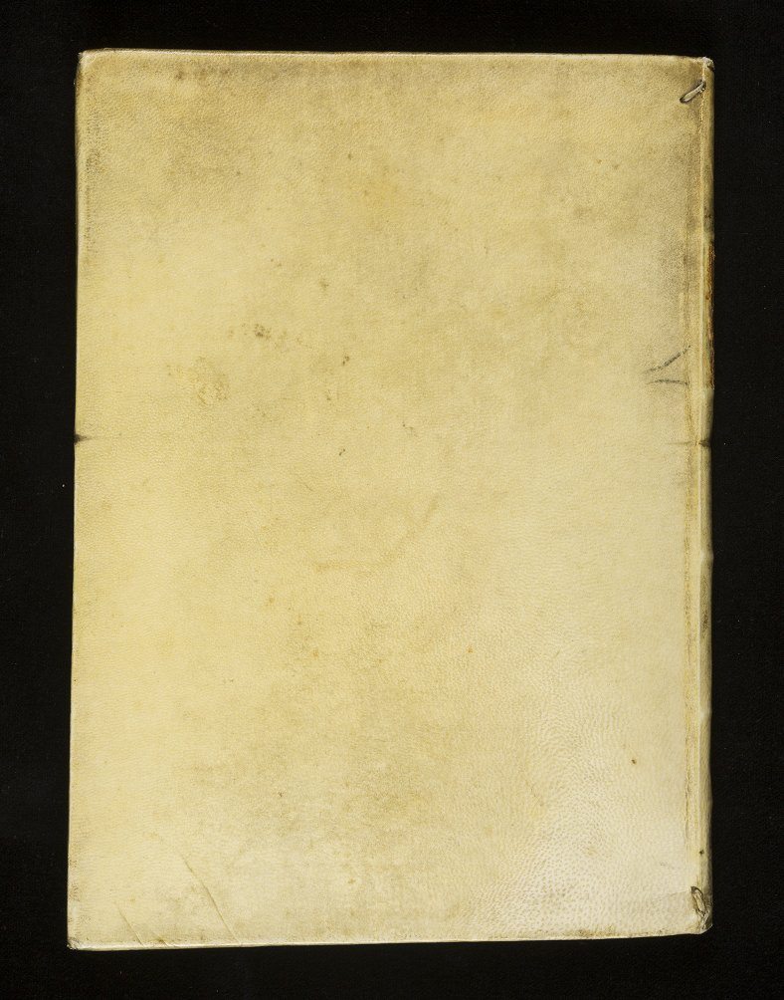

The history of fourfooted beasts and serpents -- Dilation: 1 Erosion: 18
	Merging overlapping extracts: (137, 186)-(288, 401) (26, 66)-(209, 425)
	Merging overlapping extracts: (58, 188)-(209, 302) (26, 292)-(214, 418)
	Merging overlapping extracts: (81, 270)-(182, 386) (27, 83)-(240, 383)
	Merging overlapping extracts: (28, 127)-(168, 436) (90, 60)-(199, 132)
19 missing images
648 extra images
1108 total pages
Missing:


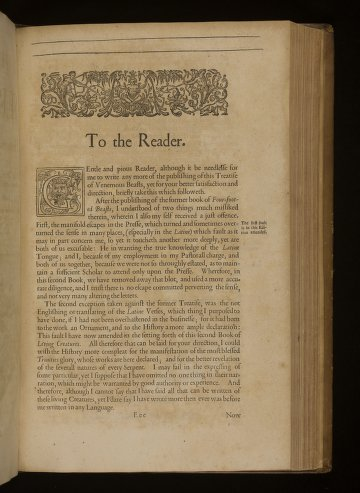

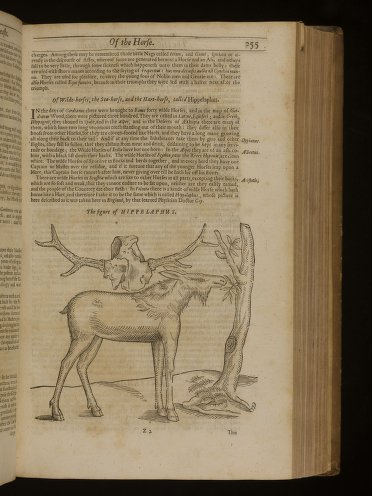

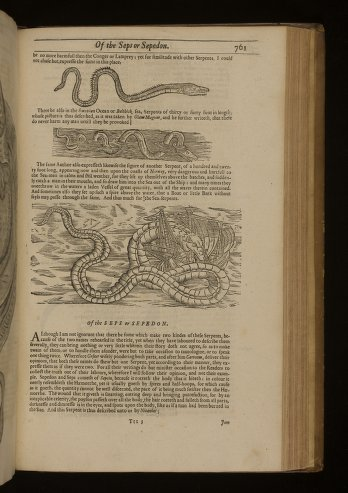

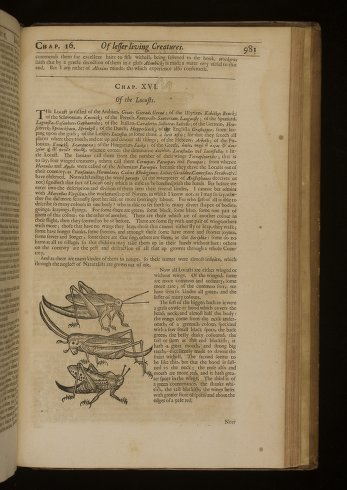

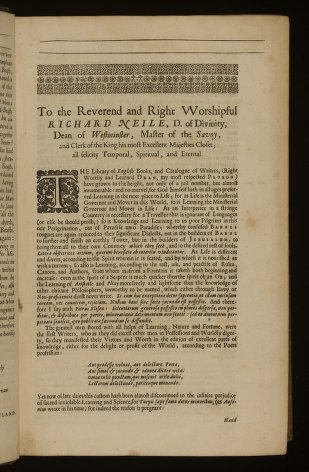

...

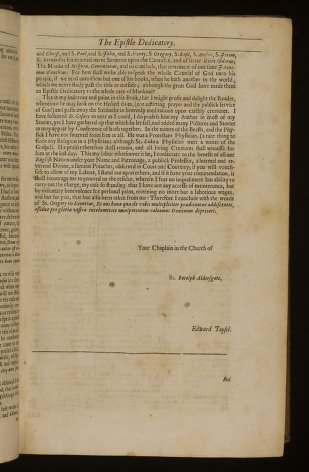

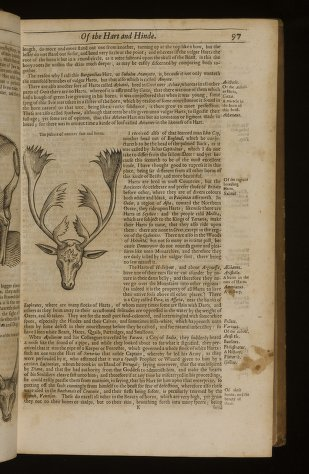

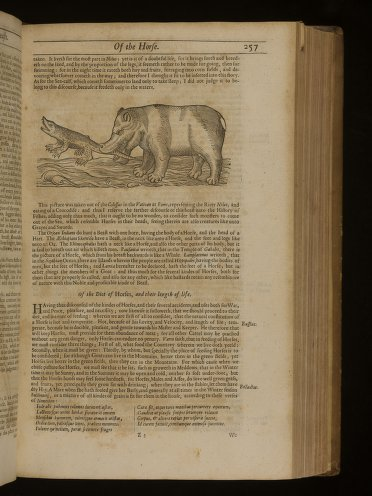

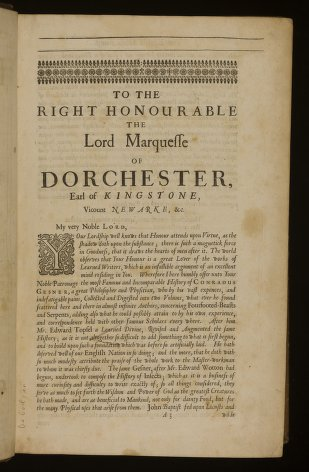

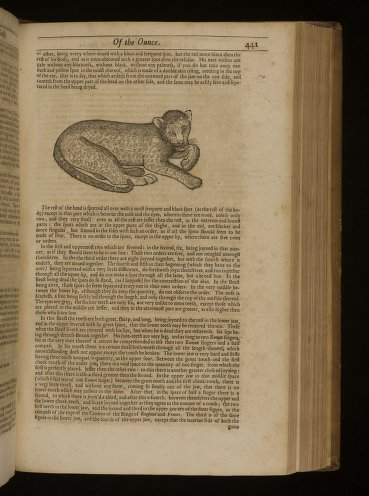

Theory of the Earth -- Dilation: 1 Erosion: 4
	Merging overlapping extracts: (129, 268)-(331, 510) (252, 200)-(474, 411)
10 missing images
5 extra images
361 total pages
Missing:


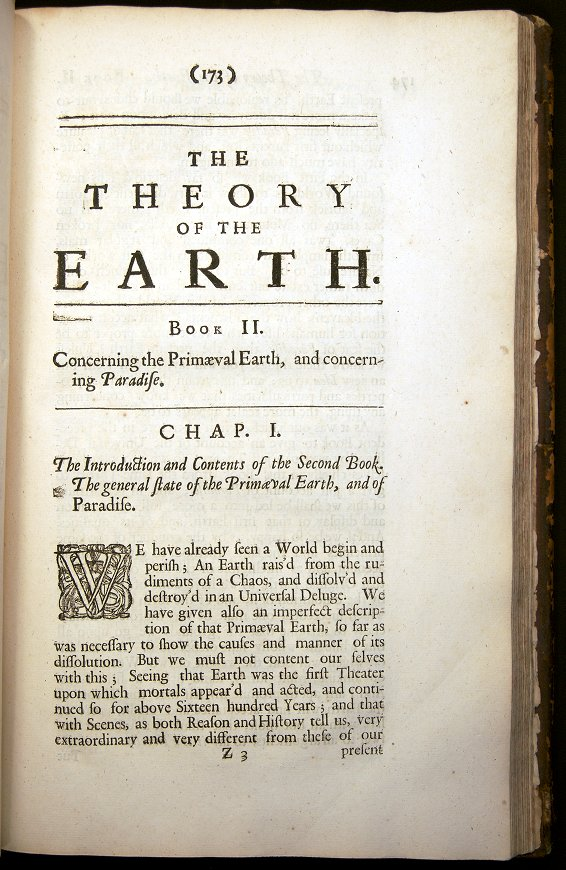

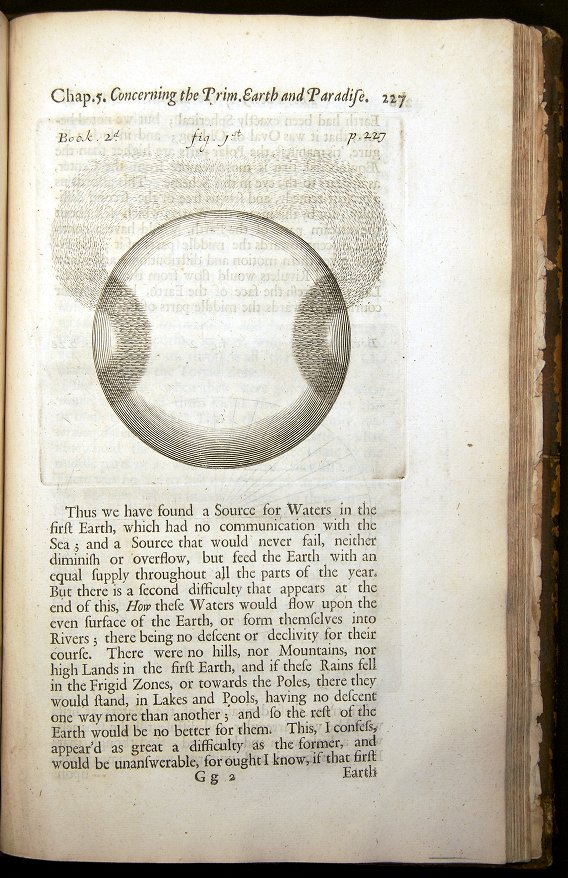

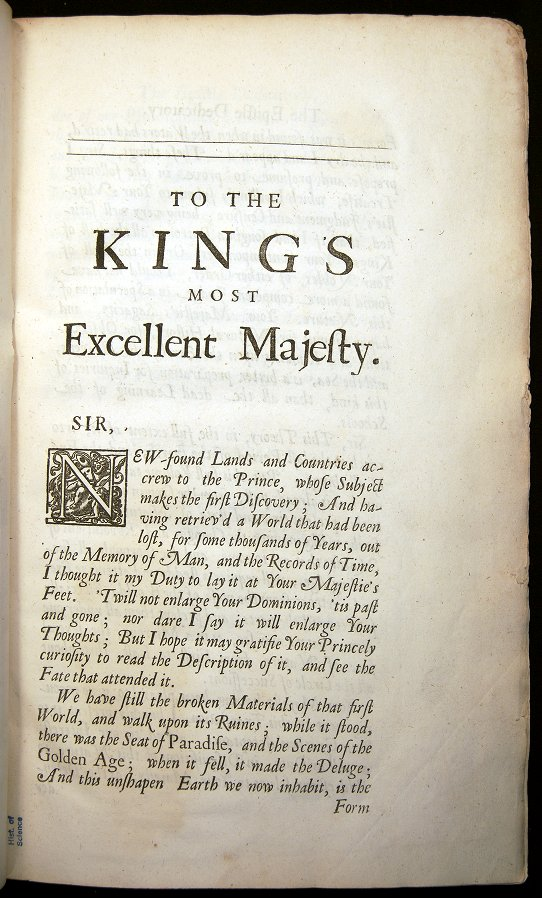

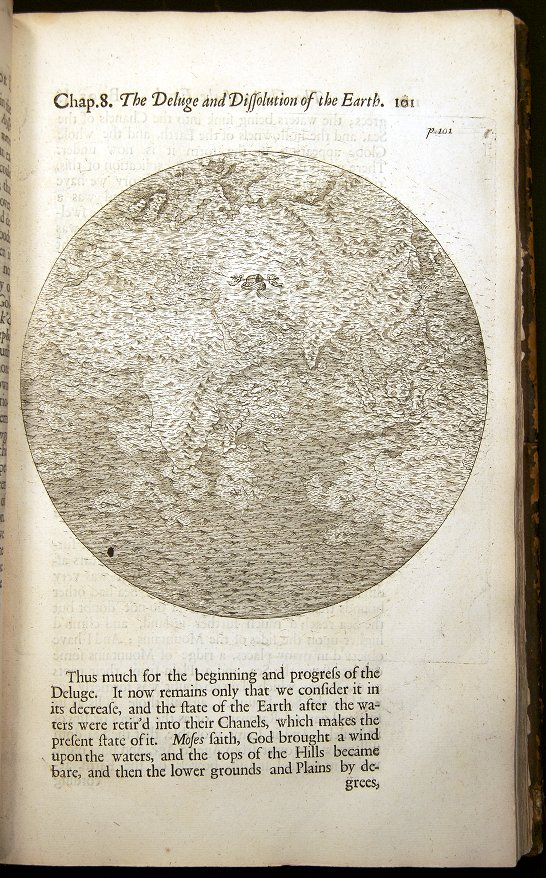

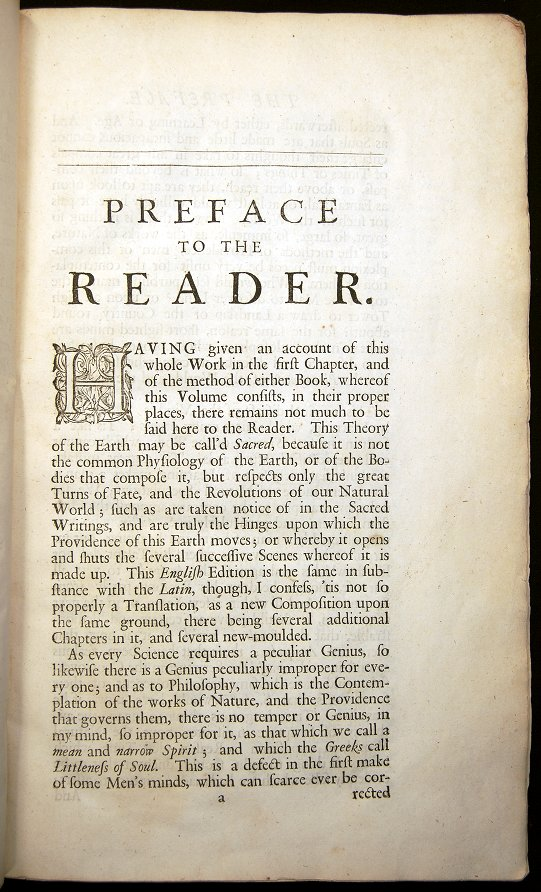

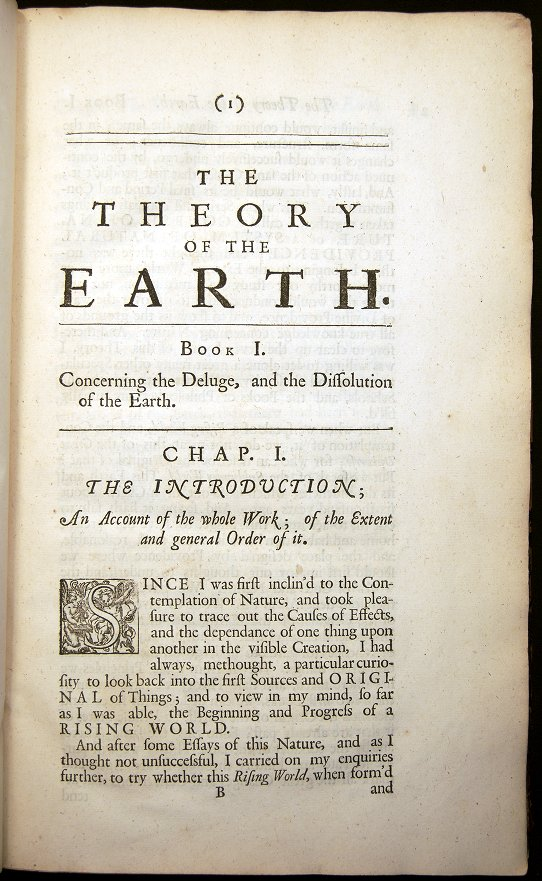

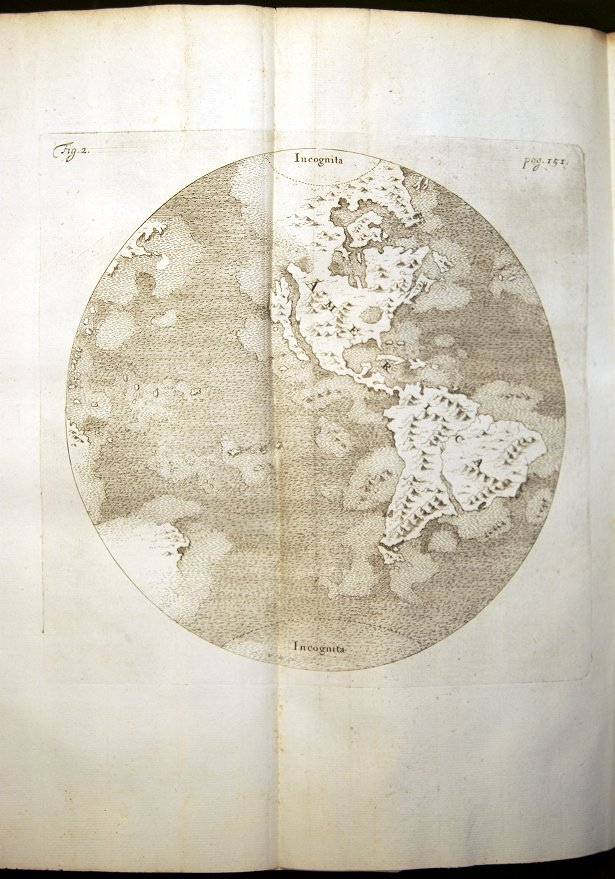

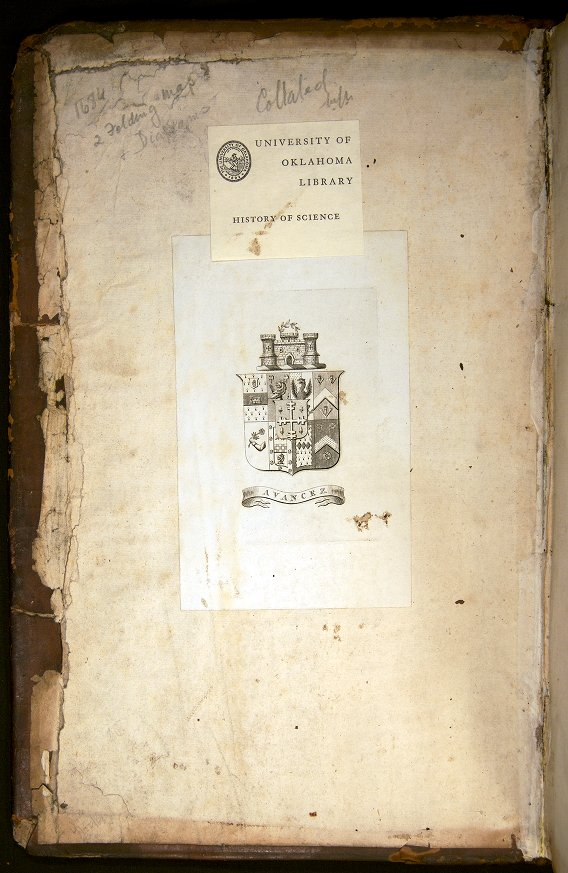

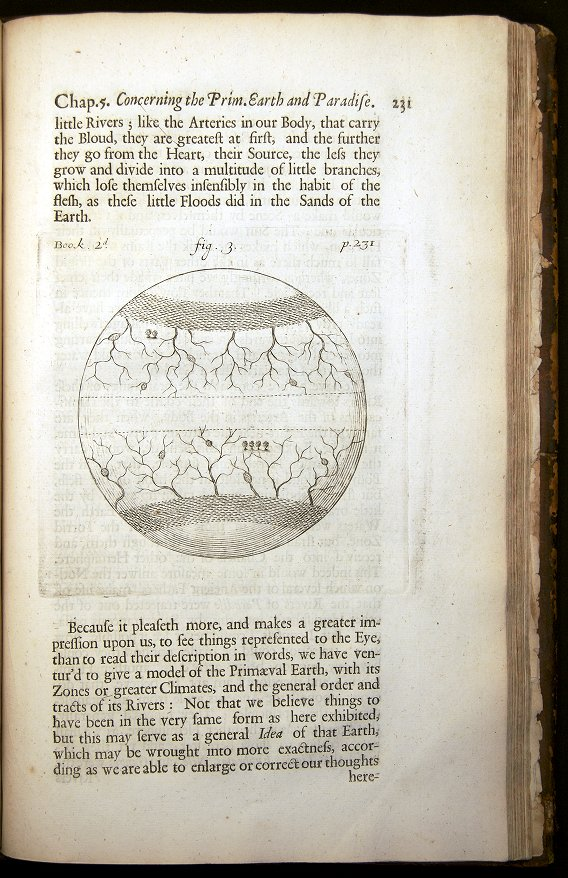

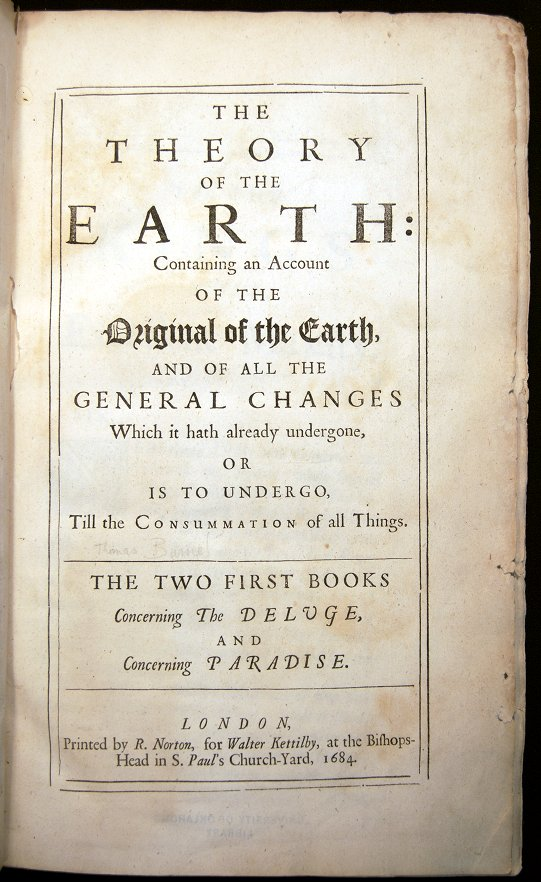

Extras:


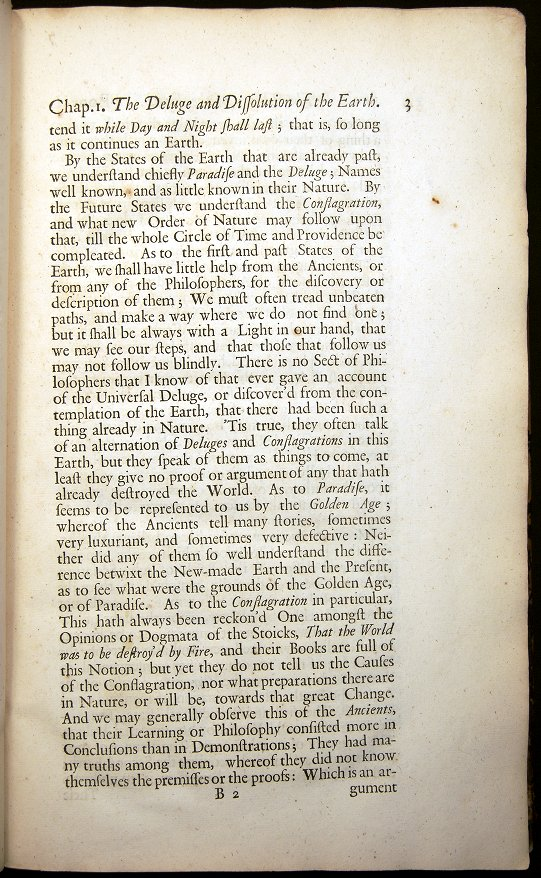

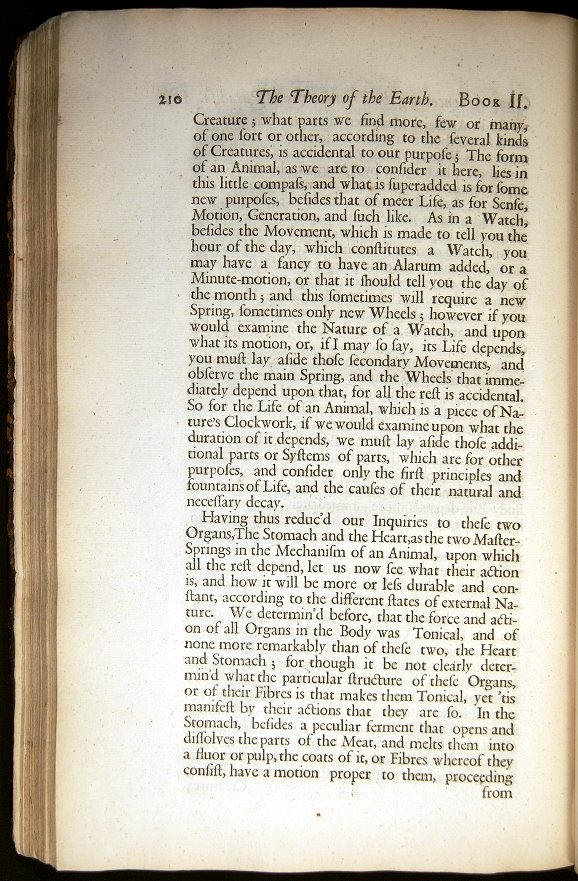

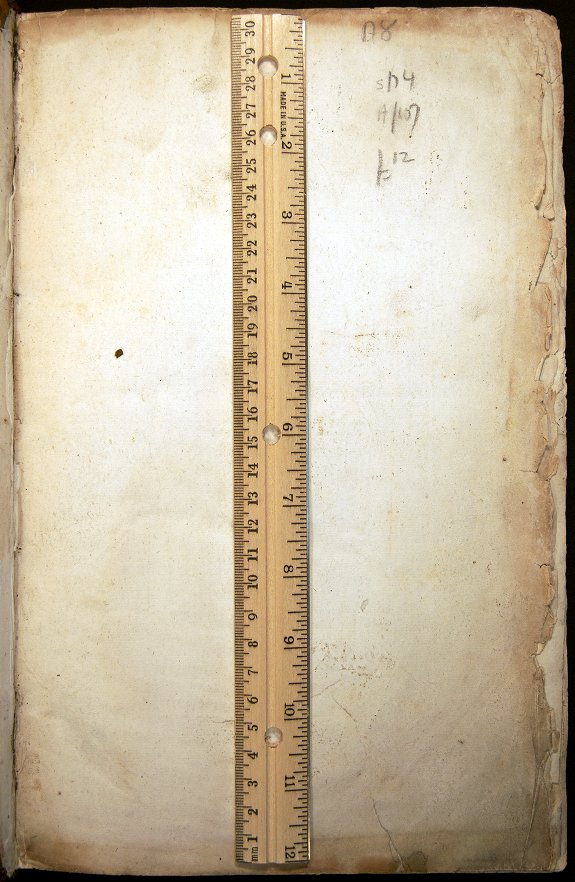

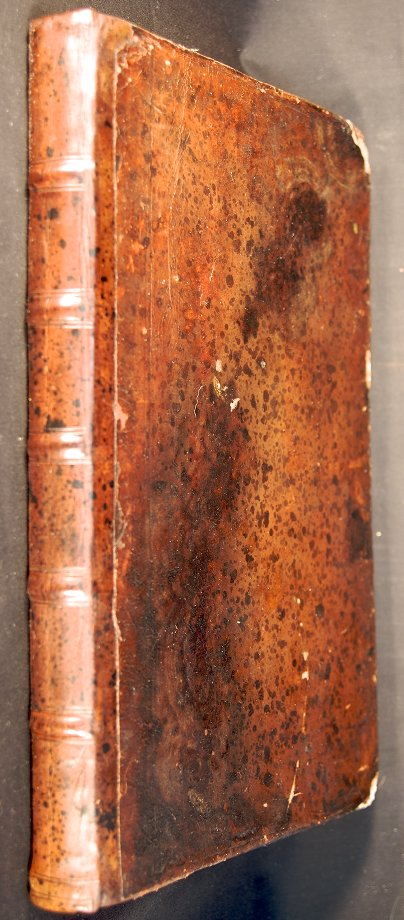

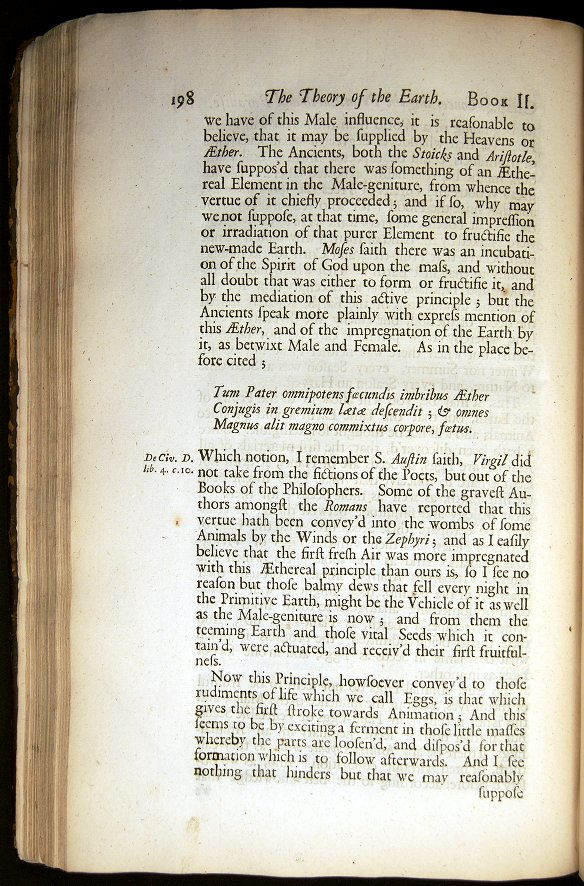

Atlas coelestis -- Dilation: 5 Erosion: 0
0 missing images
38 extra images
72 total pages
Missing:
The Natural History of Human Teeth -- Dilation: 2 Erosion: 17
3 missing images
144 extra images
334 total pages
Missing:


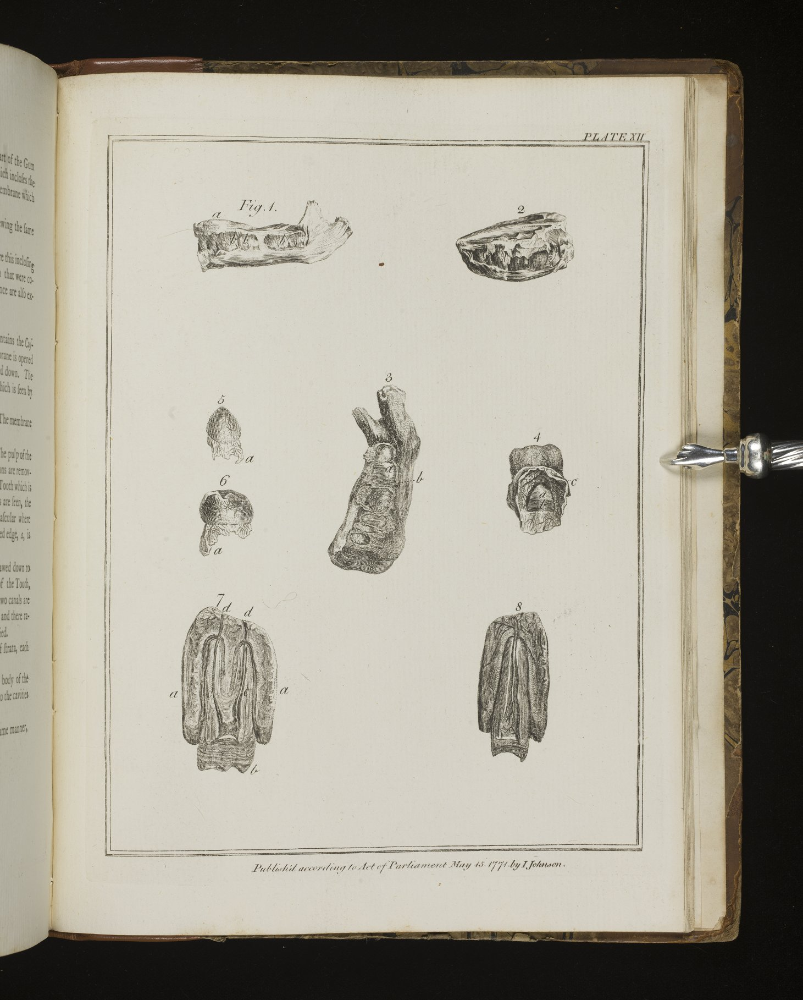

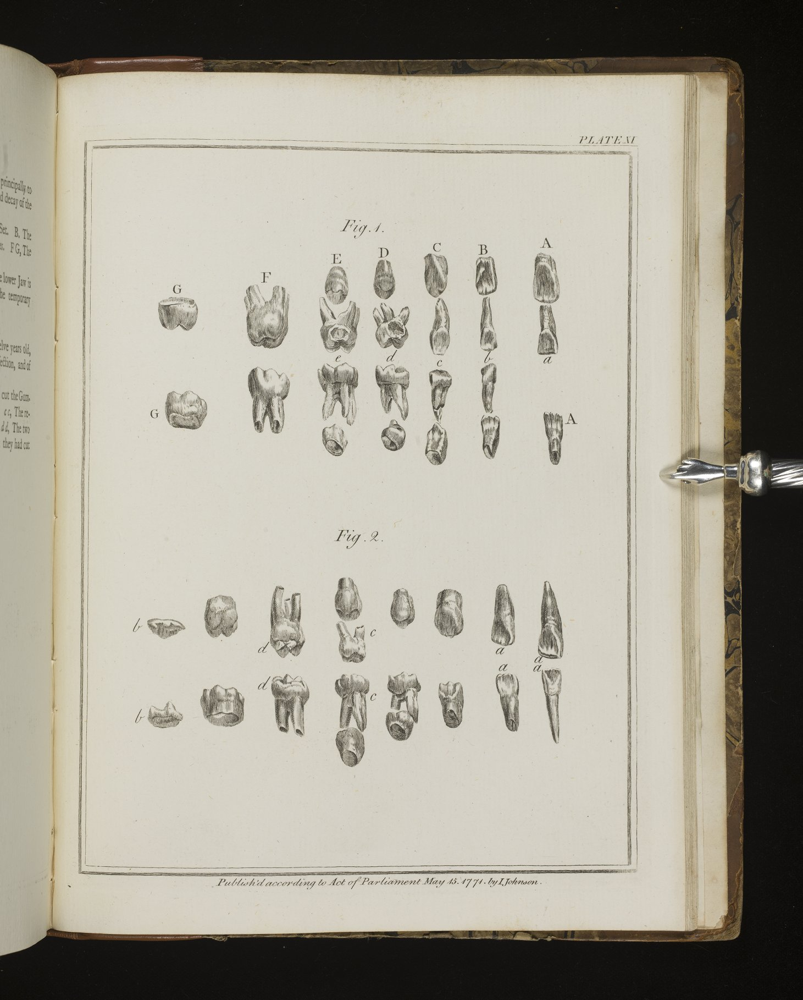

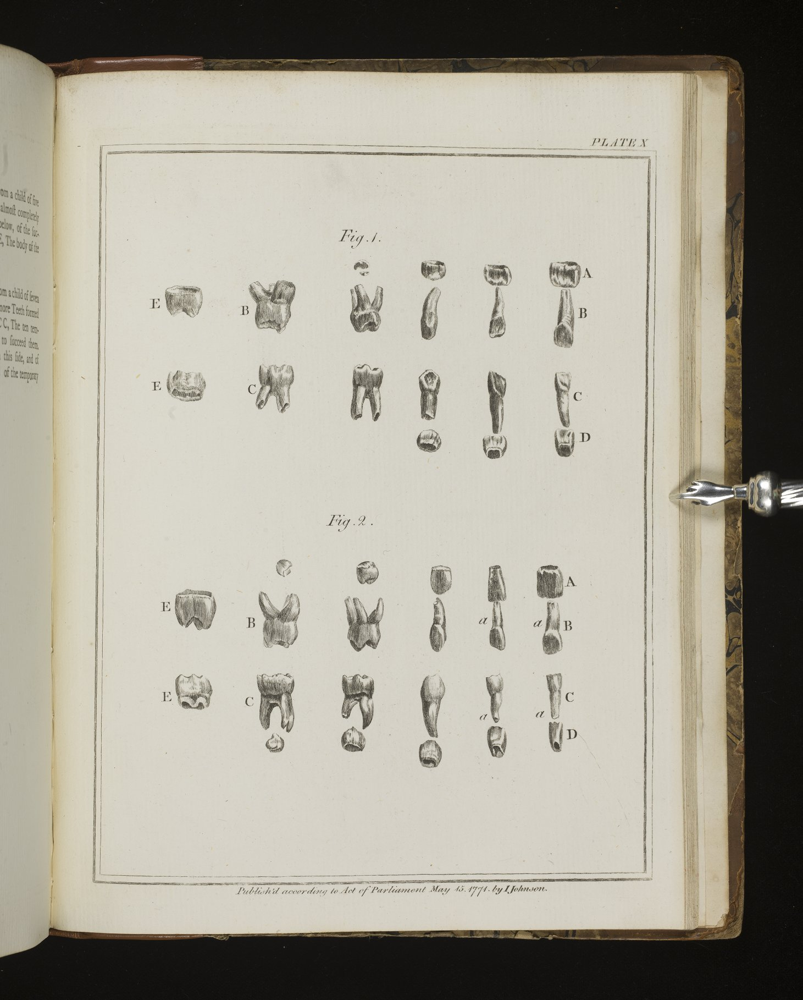

Harmonices mvndi -- Dilation: 1 Erosion: 19
	Merging overlapping extracts: (97, 30)-(294, 118) (96, 98)-(294, 382)
	Merging overlapping extracts: (189, 250)-(279, 393) (150, 196)-(278, 285)
	Merging overlapping extracts: (97, 160)-(276, 306) (136, 256)-(290, 387)
	Merging overlapping extracts: (124, 40)-(288, 161) (97, 160)-(290, 387)
	Merging overlapping extracts: (167, 170)-(266, 264) (128, 250)-(293, 407)
	Merging overlapping extracts: (97, 160)-(276, 306) (136, 256)-(290, 387)
	Merging overlapping extracts: (124, 40)-(288, 161) (97, 160)-(290, 387)
26 missing images
199 extra images
427 total pages
Missing:


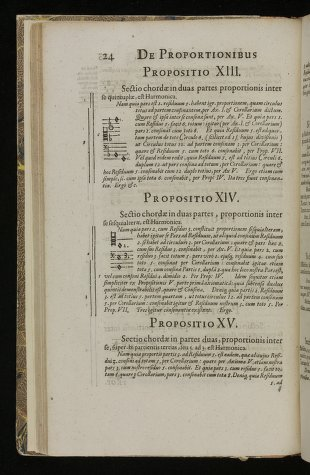

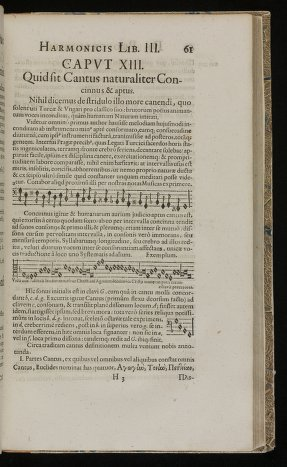

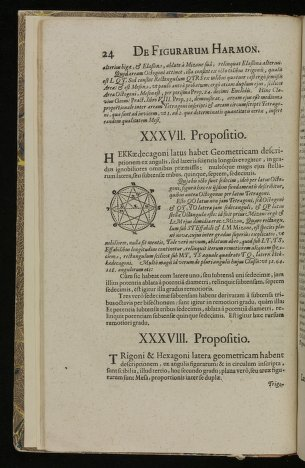

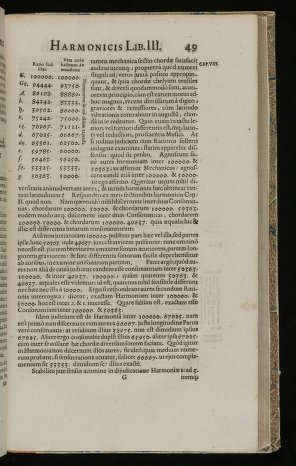

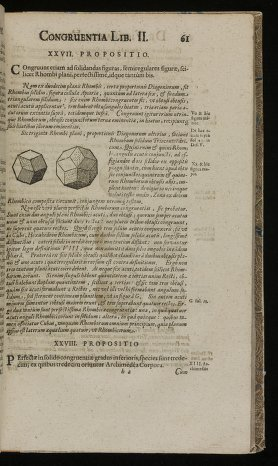

...

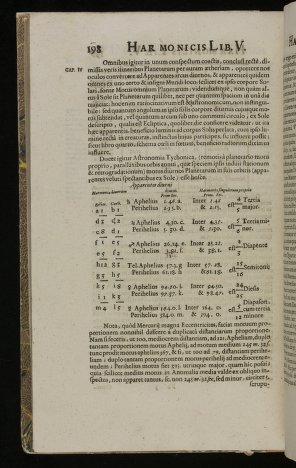

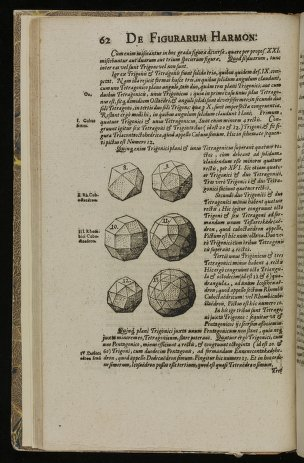

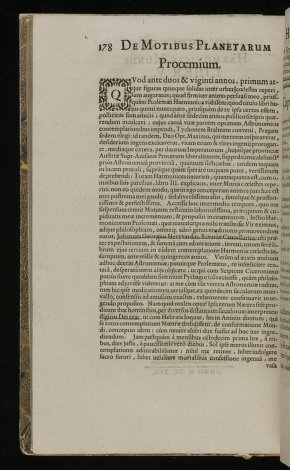

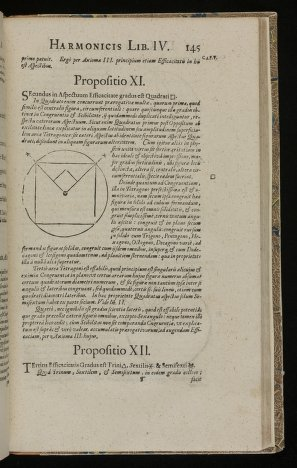

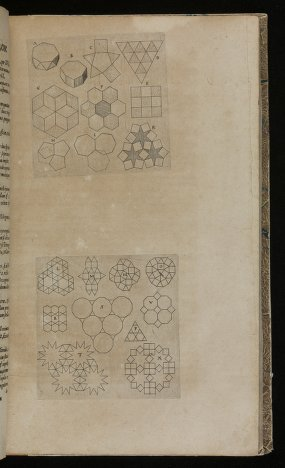

Perspectiva -- Dilation: 4 Erosion: 19
	Merging overlapping extracts: (142, 104)-(641, 456) (139, 448)-(636, 721)
	Merging overlapping extracts: (371, 577)-(615, 910) (139, 104)-(641, 721)
	Merging overlapping extracts: (139, 733)-(363, 922) (139, 104)-(641, 910)
	Merging overlapping extracts: (237, 377)-(466, 604) (397, 113)-(740, 817)
	Merging overlapping extracts: (369, 91)-(746, 652) (263, 135)-(445, 821)
	Merging overlapping extracts: (248, 791)-(743, 909) (263, 91)-(746, 821)
0 missing images
38 extra images
109 total pages
Missing:
The Systeme of the World in Four Dialogues in Thomas Salusbury Mathematical Discourses 1661 -- Dilation: 2 Erosion: 17
	Merging overlapping extracts: (22, 110)-(261, 230) (21, 46)-(269, 111)
	Merging overlapping extracts: (59, 250)-(168, 365) (60, 48)-(627, 480)
6 missing images
15 extra images
176 total pages
Missing:


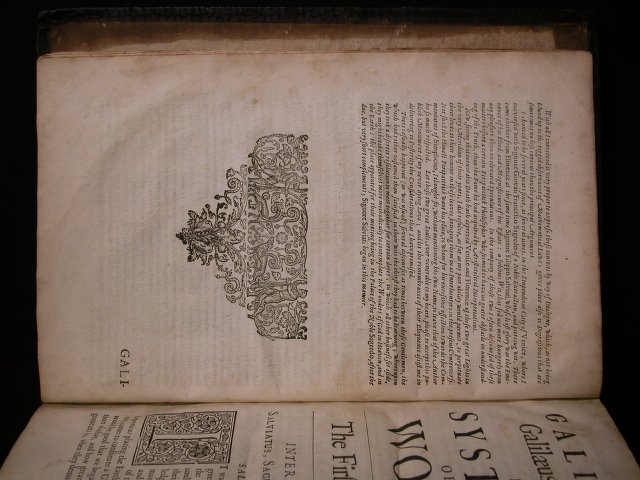

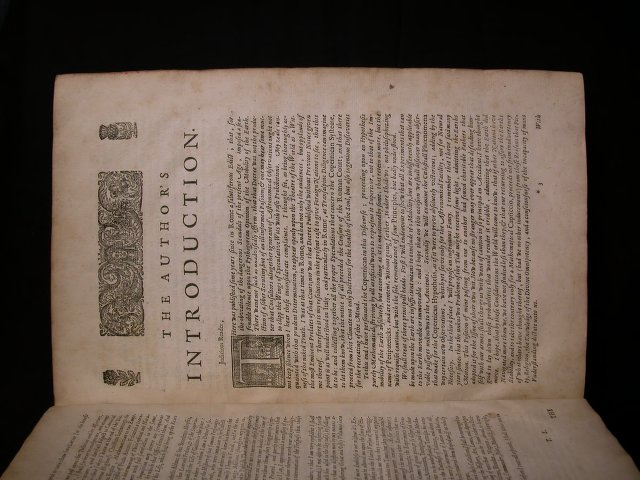

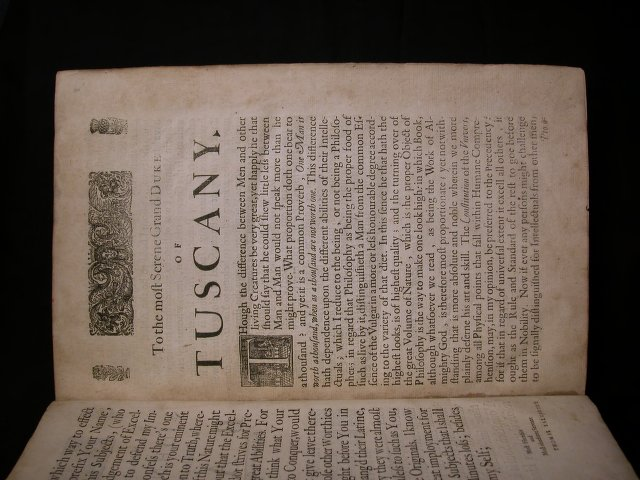

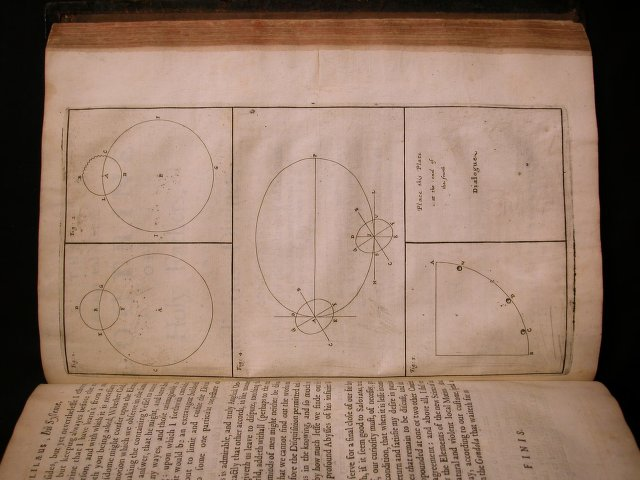

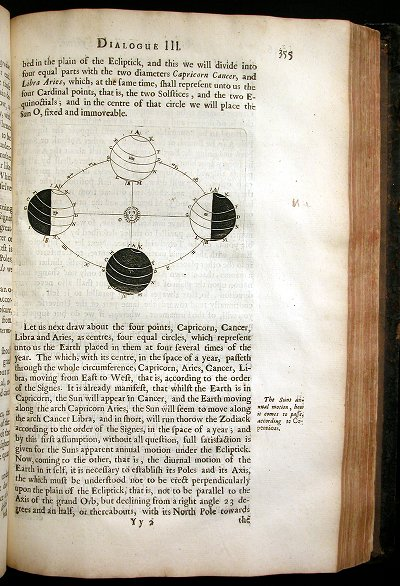

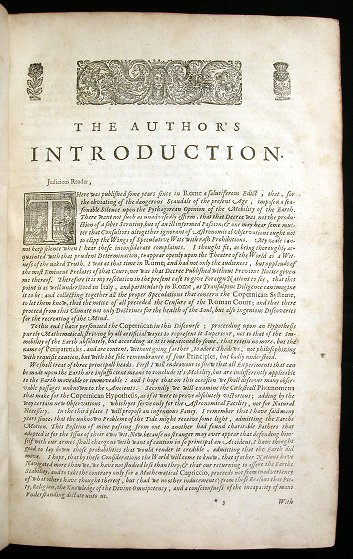

Extras:


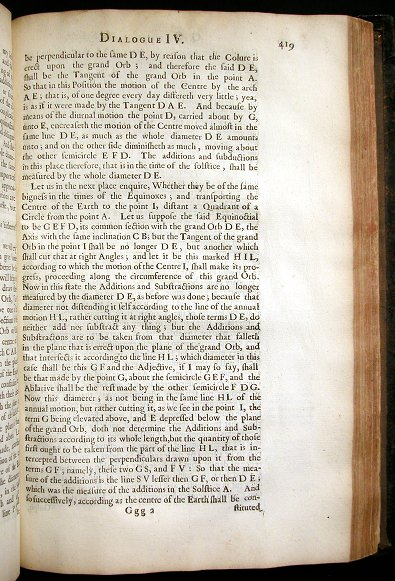

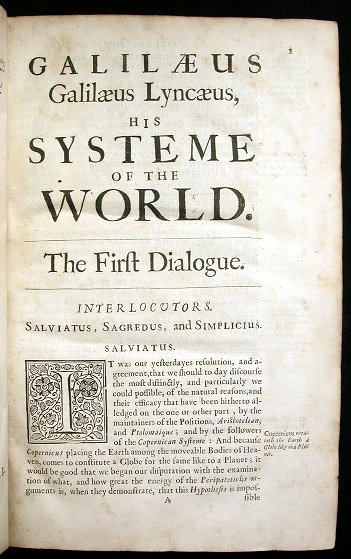

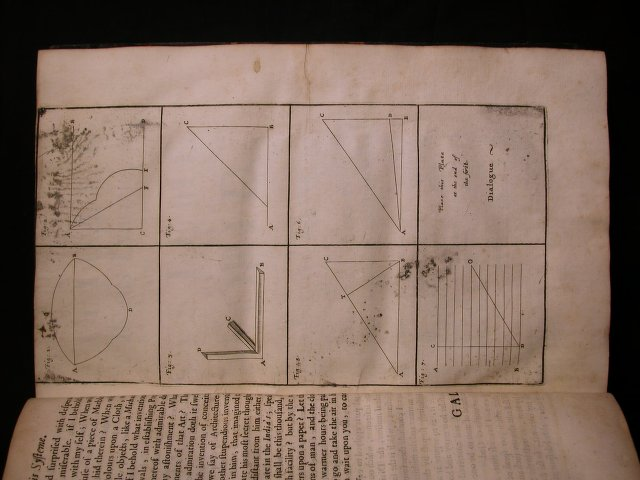

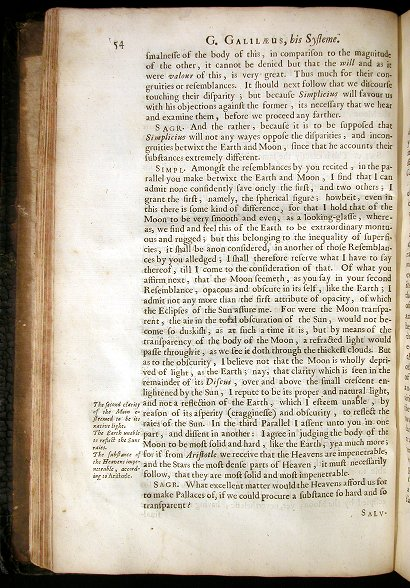

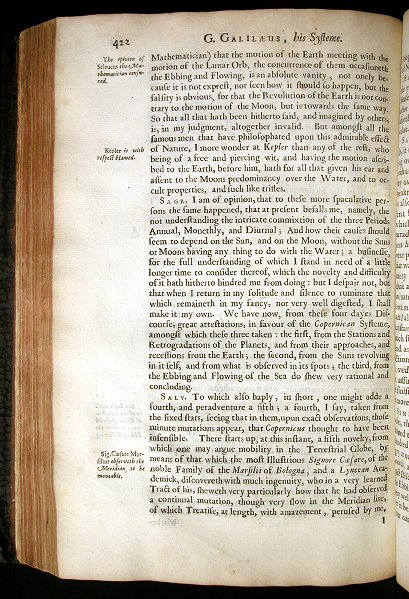

...

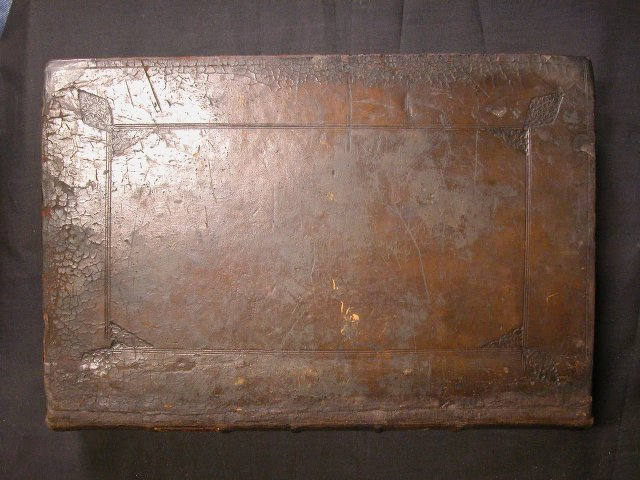

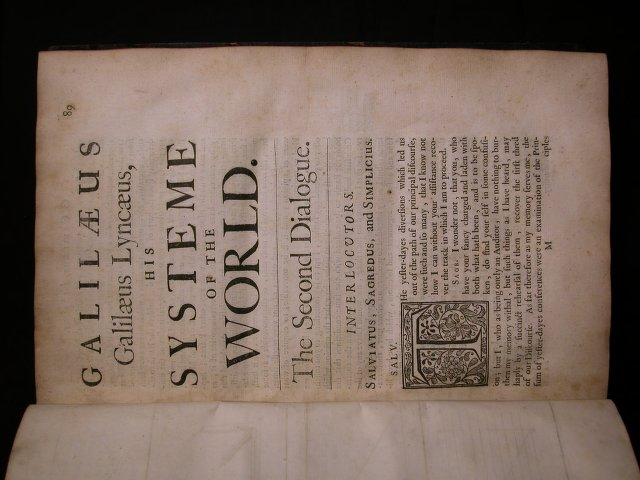

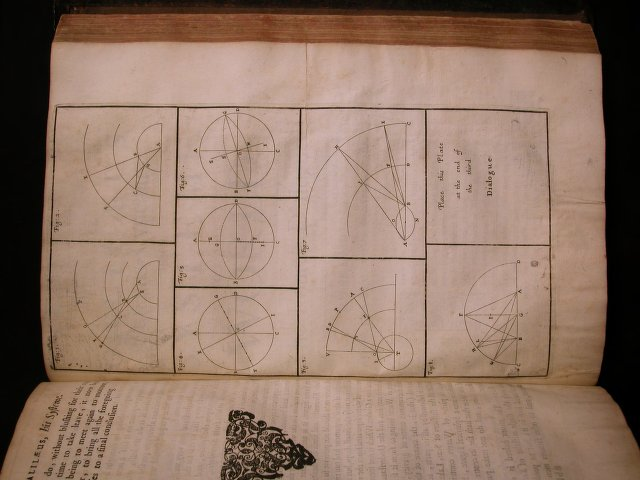

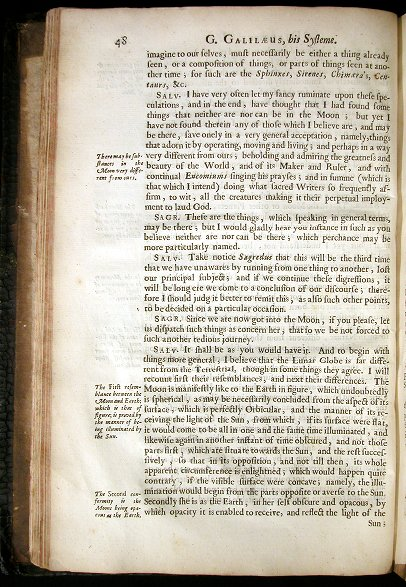

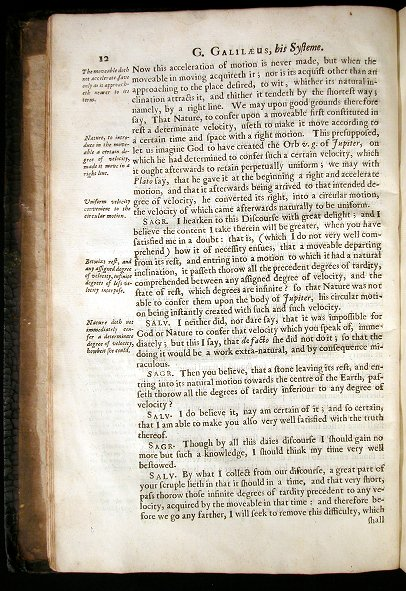

Discorso delle comete di mario Gvidvcci... -- Dilation: 2 Erosion: 8
	Merging overlapping extracts: (256, 522)-(592, 680) (187, 166)-(595, 523)
	Merging overlapping extracts: (119, 427)-(269, 578) (109, 428)-(528, 767)
	Merging overlapping extracts: (263, 201)-(584, 342) (200, 300)-(585, 553)
	Merging overlapping extracts: (132, 216)-(551, 787) (138, 151)-(552, 298)
	Merging overlapping extracts: (173, 151)-(591, 507) (173, 489)-(593, 765)
1 missing images
18 extra images
69 total pages
Missing:


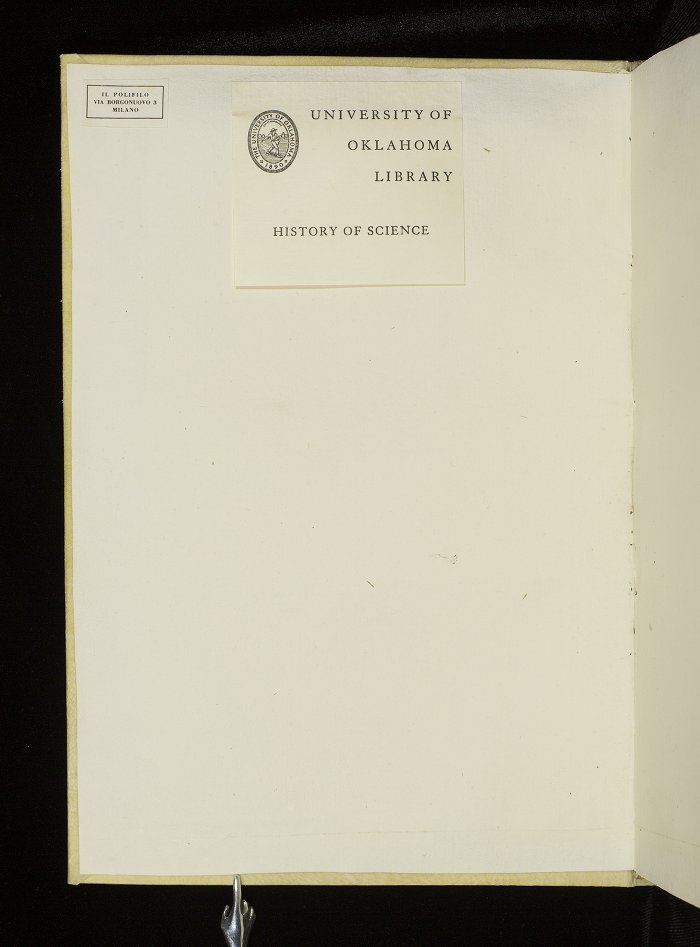

Extras:


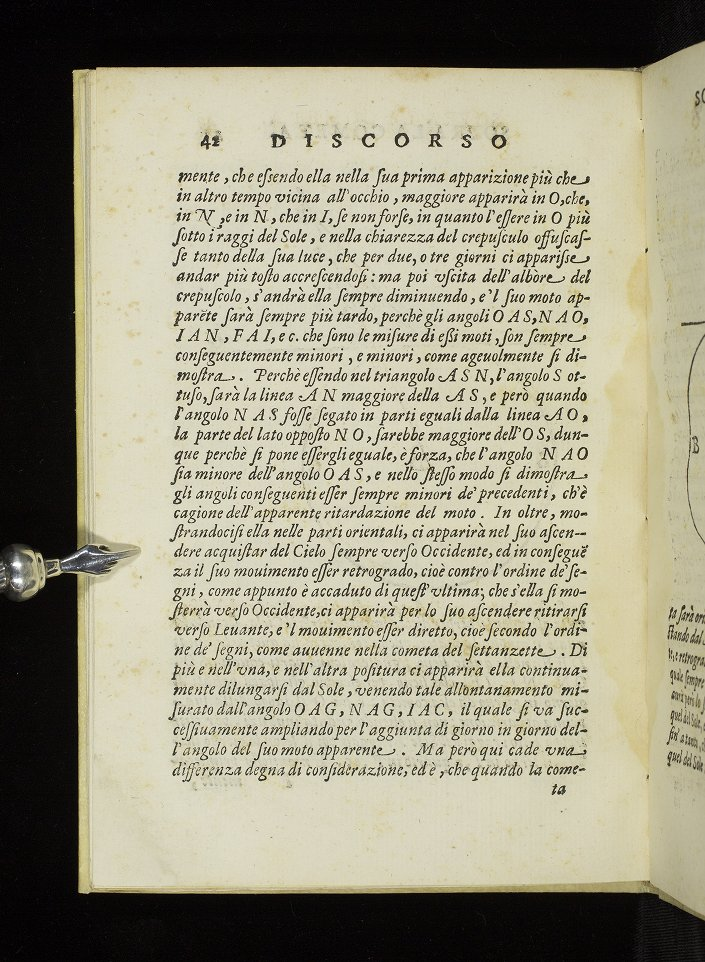

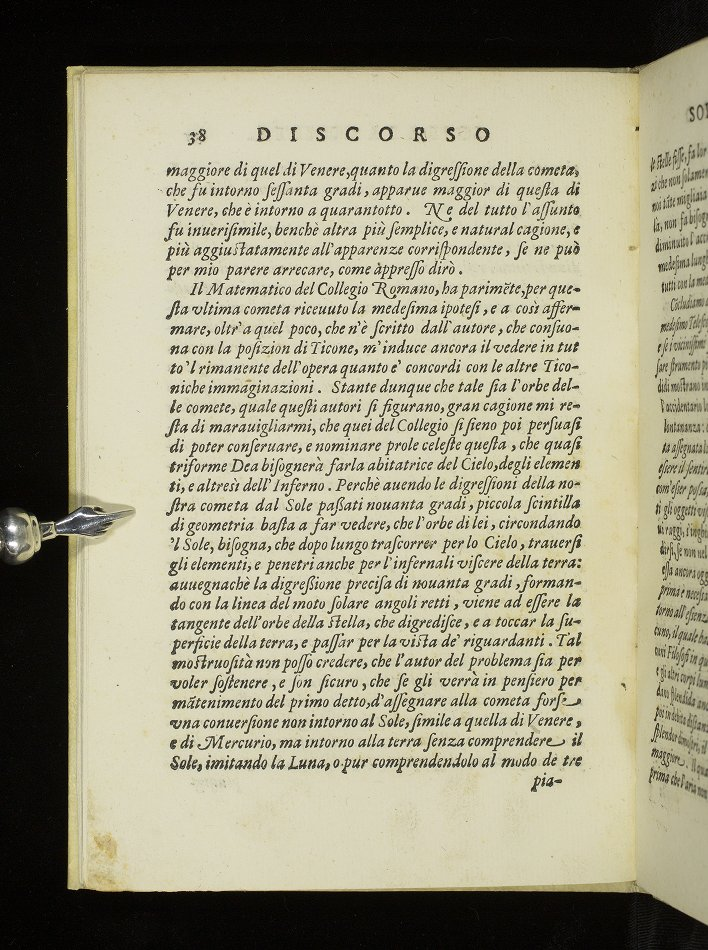

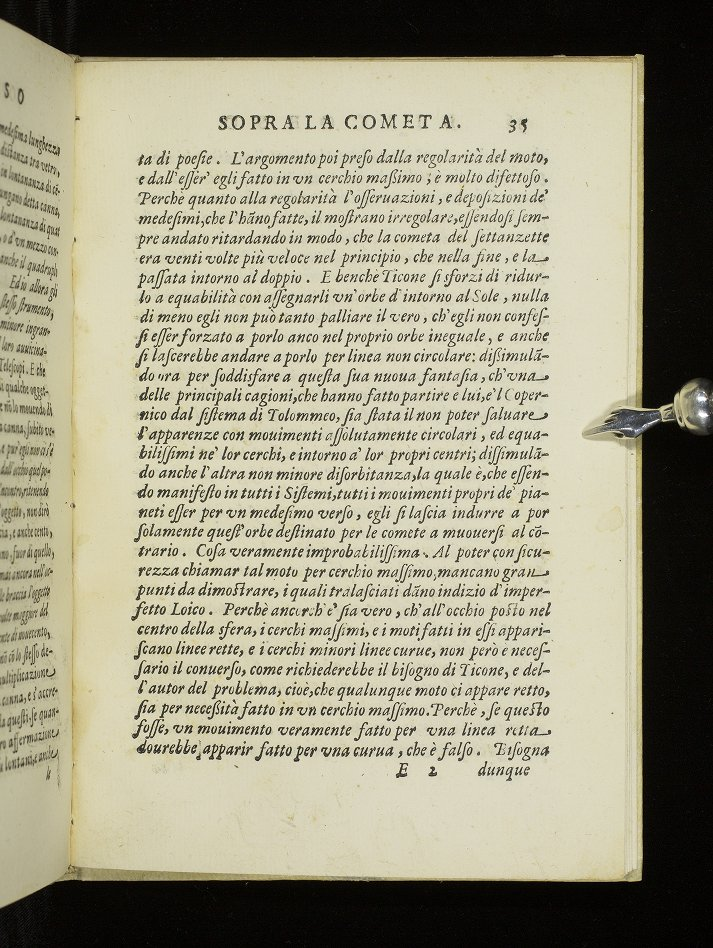

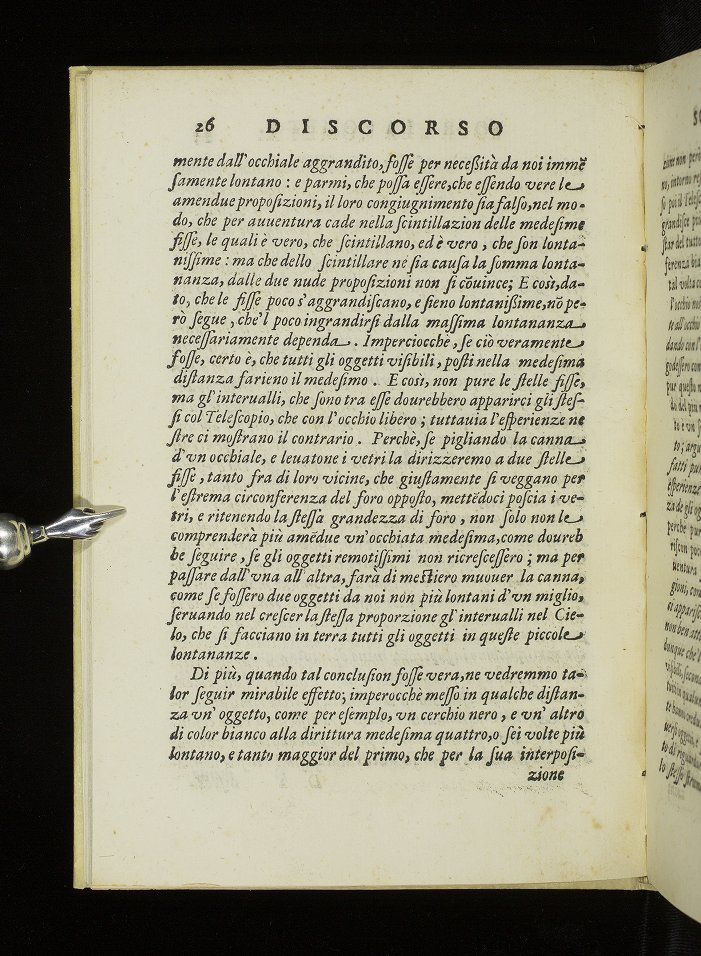

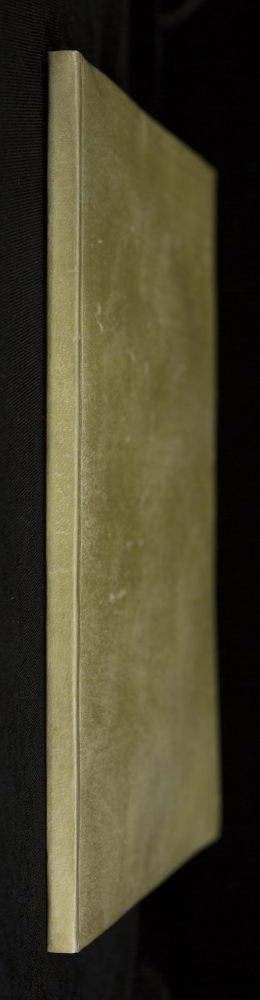

...

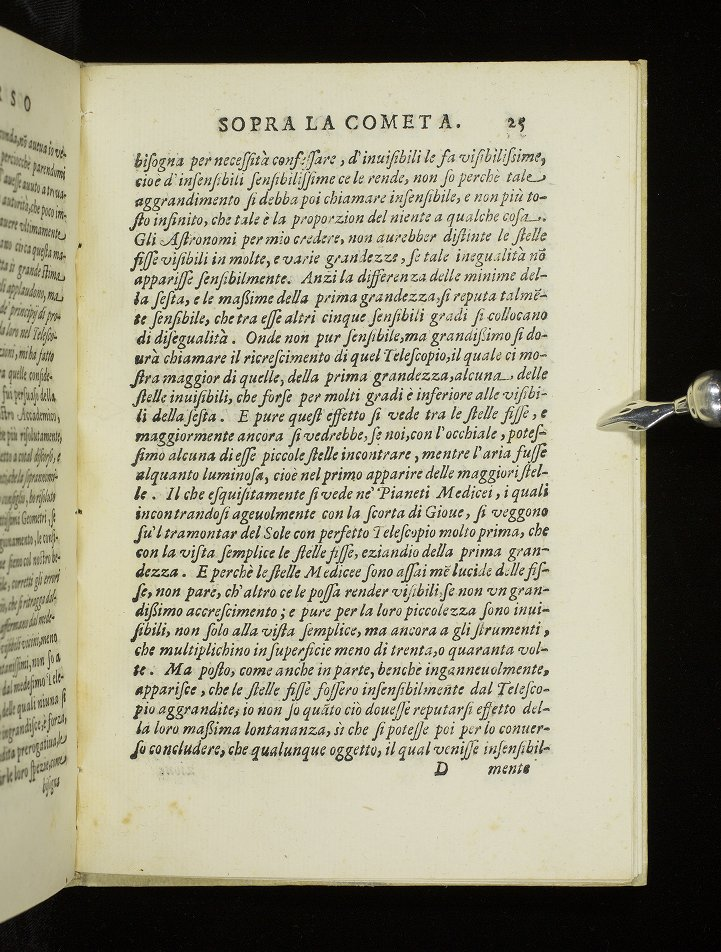

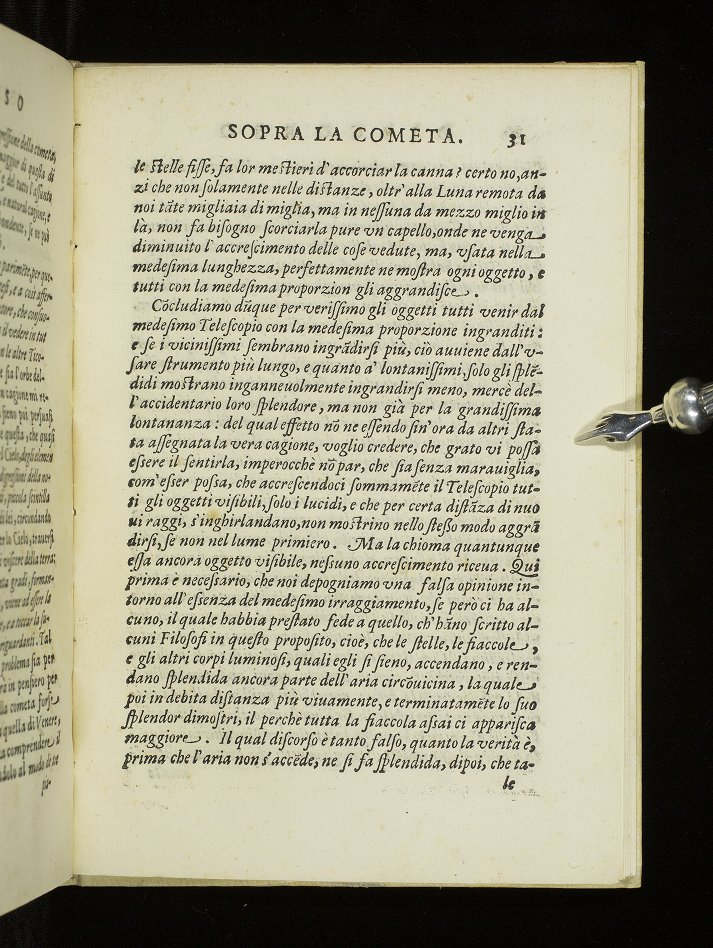

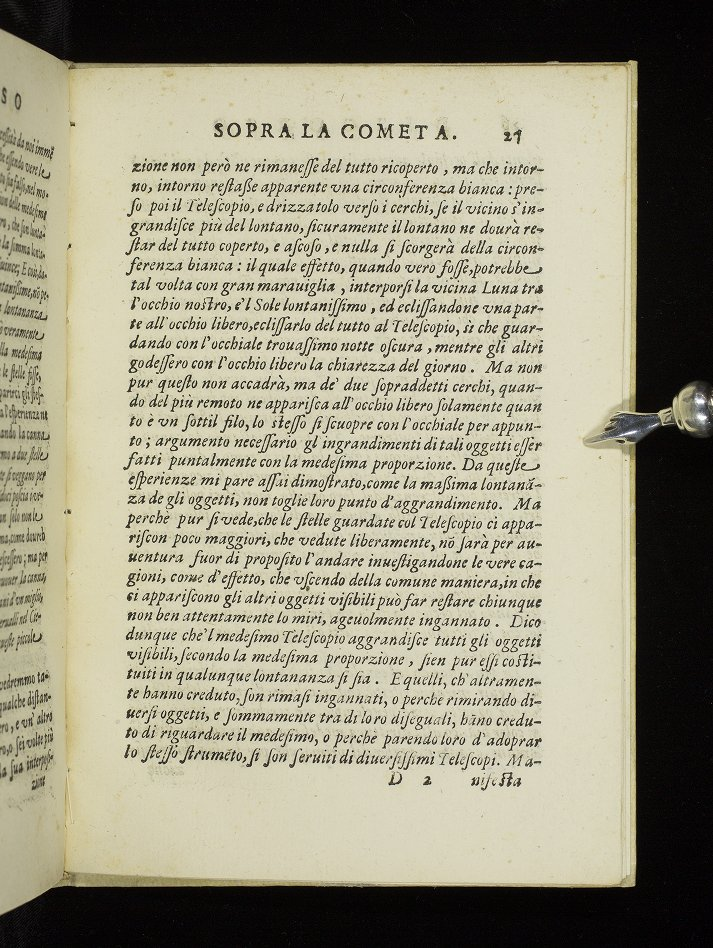

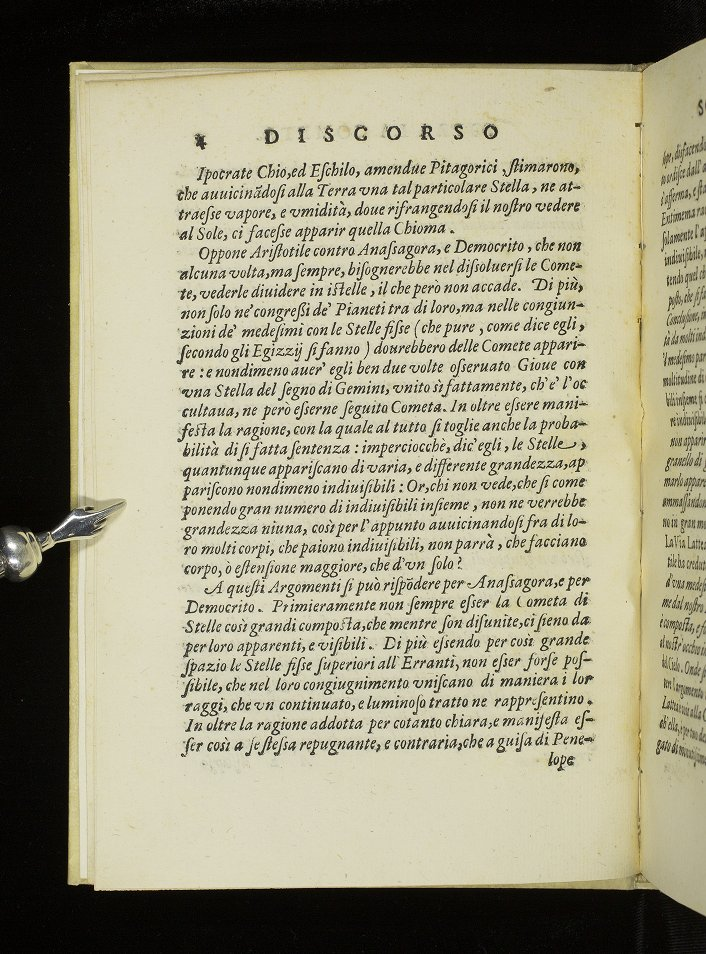

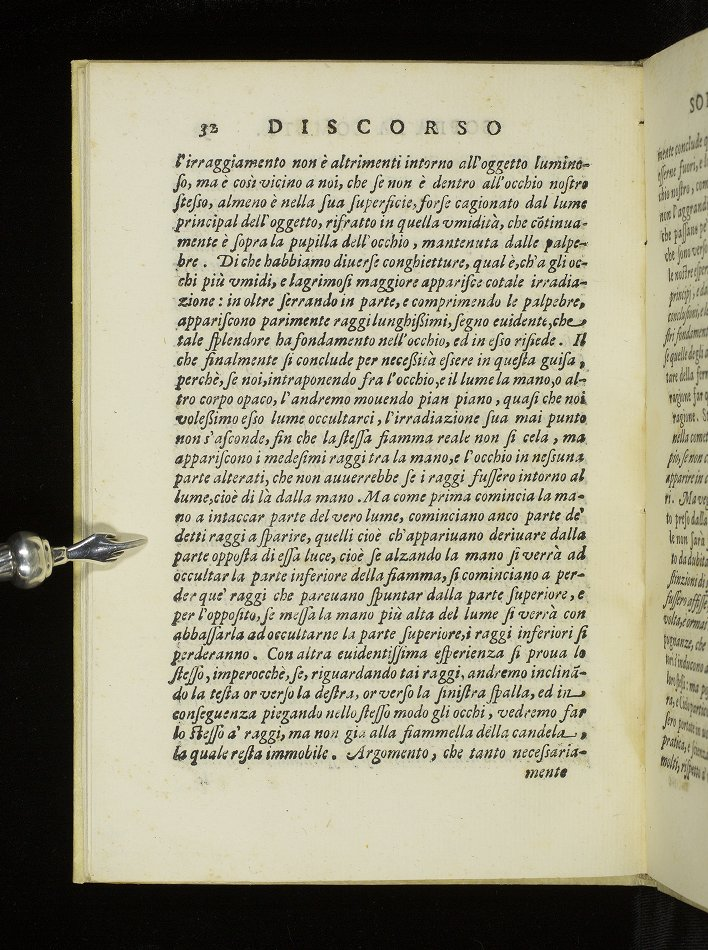

Micrographia -- Dilation: 3 Erosion: 2
	Merging overlapping extracts: (336, 176)-(476, 428) (47, 160)-(408, 433)
	Merging overlapping extracts: (101, 184)-(287, 365) (253, 167)-(466, 370)
	Merging overlapping extracts: (102, 303)-(284, 484) (208, 161)-(400, 330)
	Merging overlapping extracts: (32, 106)-(199, 277) (102, 161)-(400, 484)
	Merging overlapping extracts: (336, 176)-(476, 428) (47, 160)-(408, 433)
20 missing images
5 extra images
709 total pages
Missing:


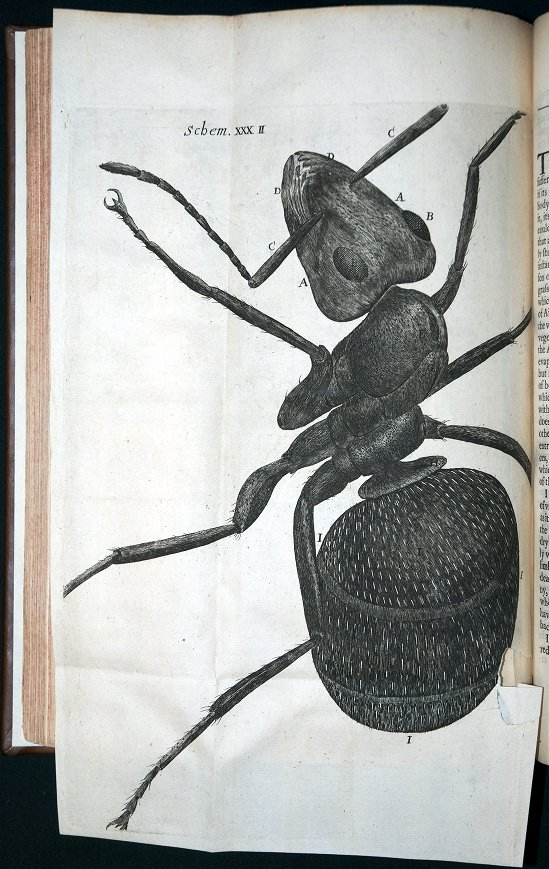

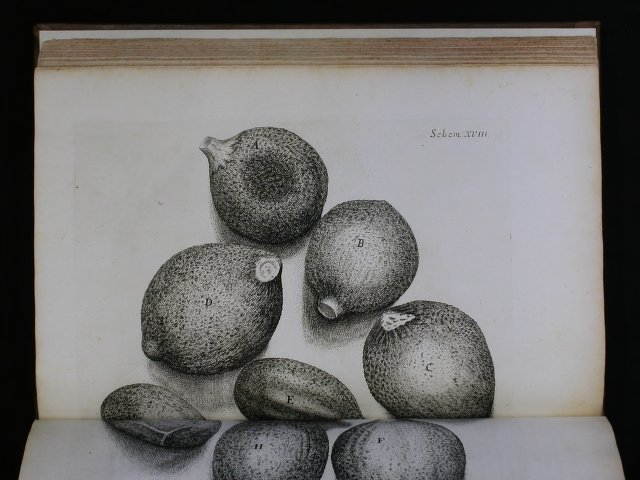

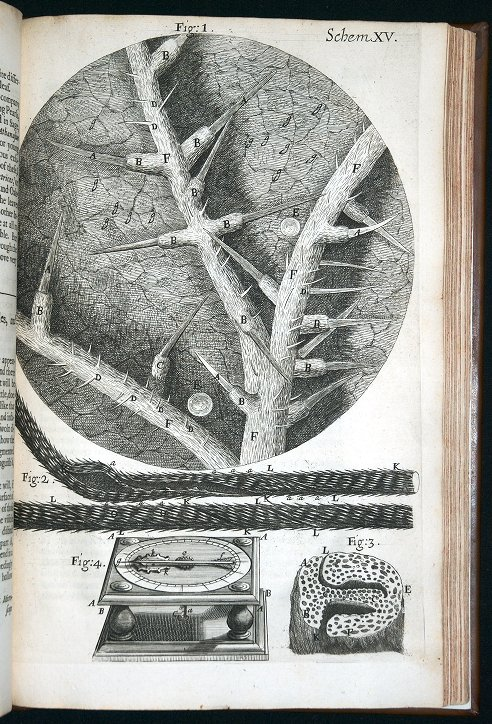

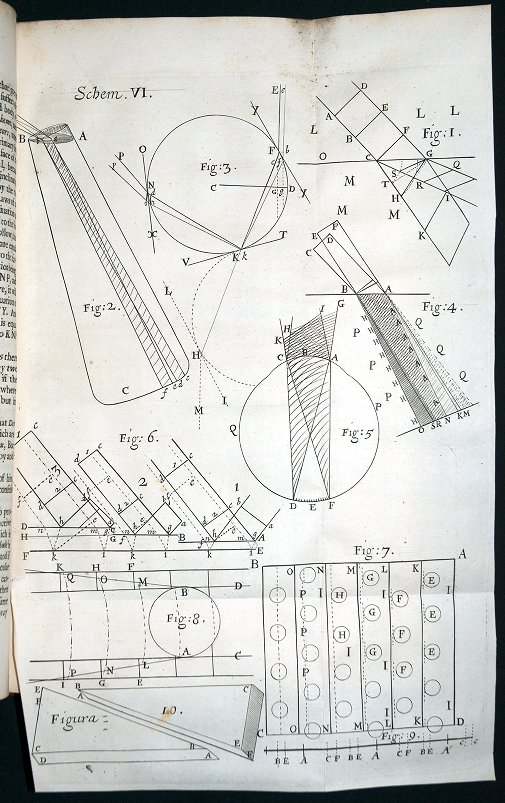

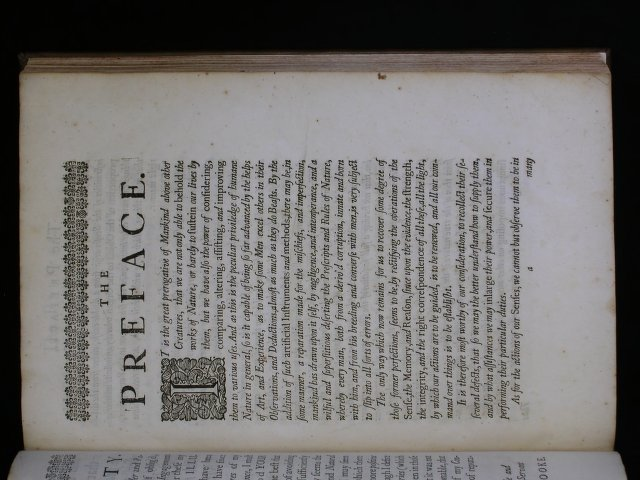

...

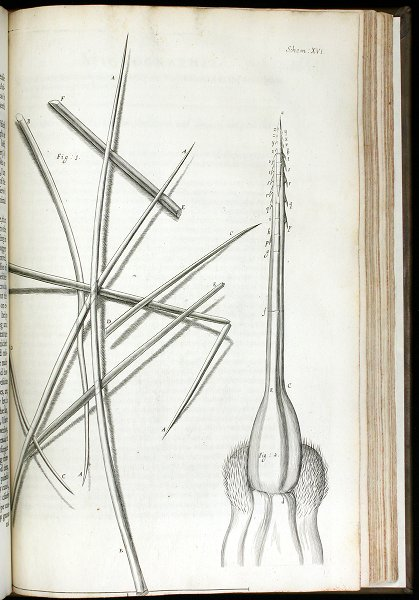

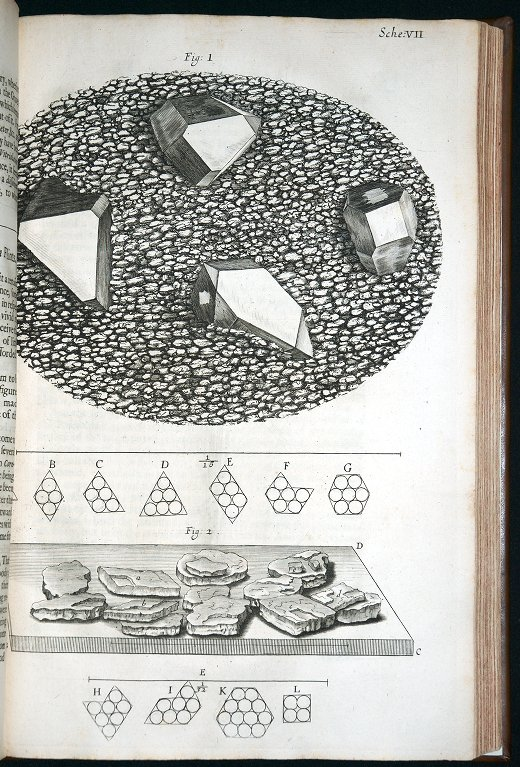

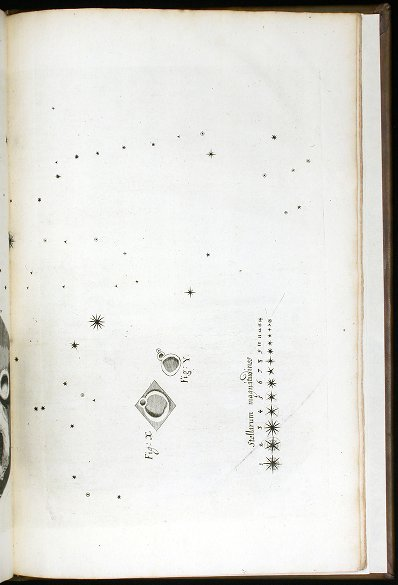

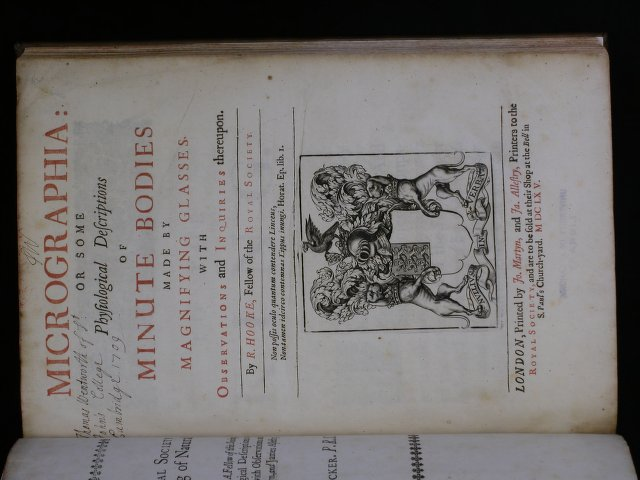

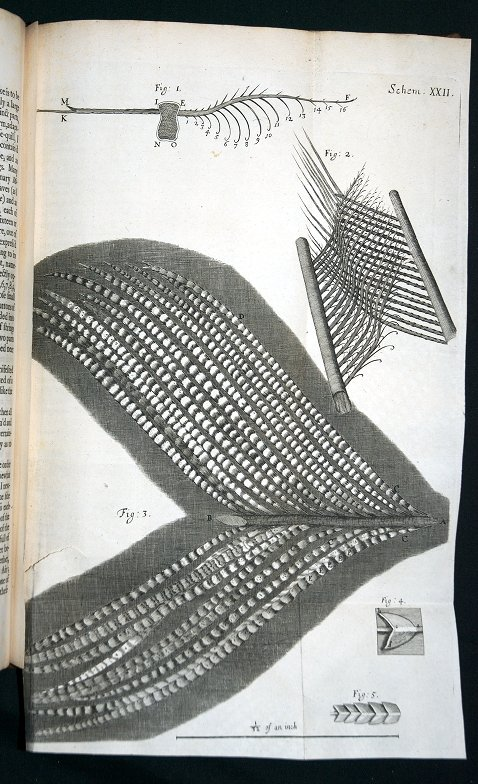

Extras:


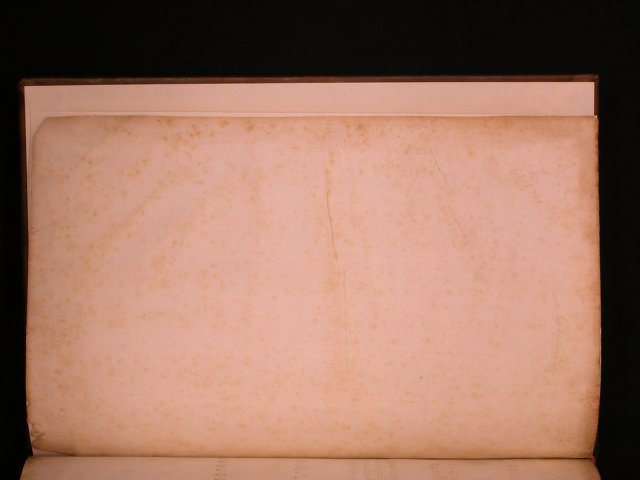

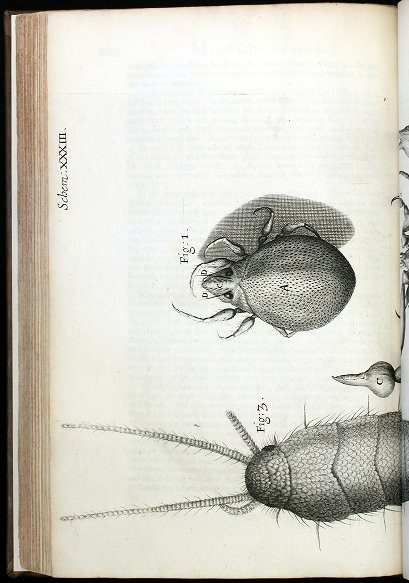

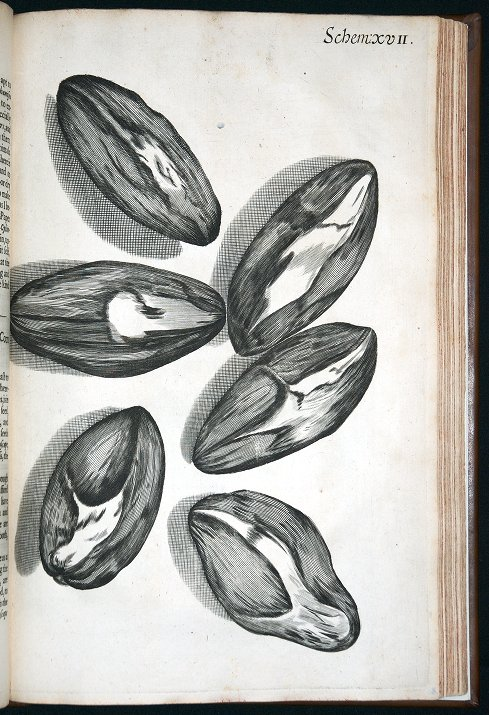

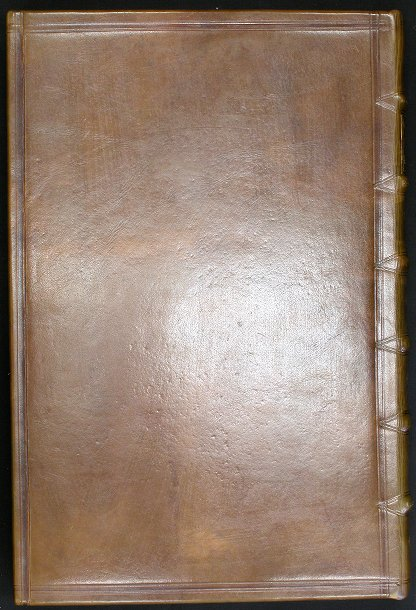

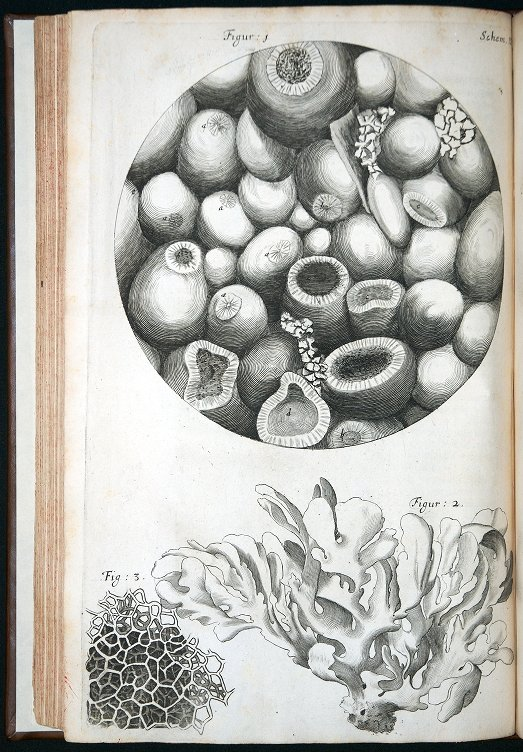

Rosa Vrsina -- Dilation: 1 Erosion: 19
	Merging overlapping extracts: (105, 176)-(239, 299) (35, 72)-(318, 197)
	Merging overlapping extracts: (41, 263)-(326, 382) (35, 72)-(318, 299)
	Merging overlapping extracts: (73, 108)-(233, 183) (45, 171)-(308, 326)
	Merging overlapping extracts: (110, 228)-(353, 446) (255, 125)-(358, 234)
	Merging overlapping extracts: (138, 42)-(336, 201) (110, 125)-(358, 446)
	Merging overlapping extracts: (9, 181)-(144, 356) (143, 144)-(282, 385)
	Merging overlapping extracts: (94, 98)-(254, 181) (125, 44)-(336, 99)
	Merging overlapping extracts: (224, 269)-(348, 396) (129, 342)-(255, 446)
	Merging overlapping extracts: (141, 54)-(251, 368) (201, 319)-(358, 456)
	Merging overlapping extracts: (252, 117)-(361, 299) (141, 54)-(358, 456)
	Merging overlapping extracts: (176, 46)-(338, 124) (141, 54)-(361, 456)
	Merging overlapping extracts: (121, 272)-(242, 395) (38, 244)-(146, 369)
	Merging overlapping extracts: (146, 67)-(254, 142) (8, 39)-(251, 435)
	Merging 

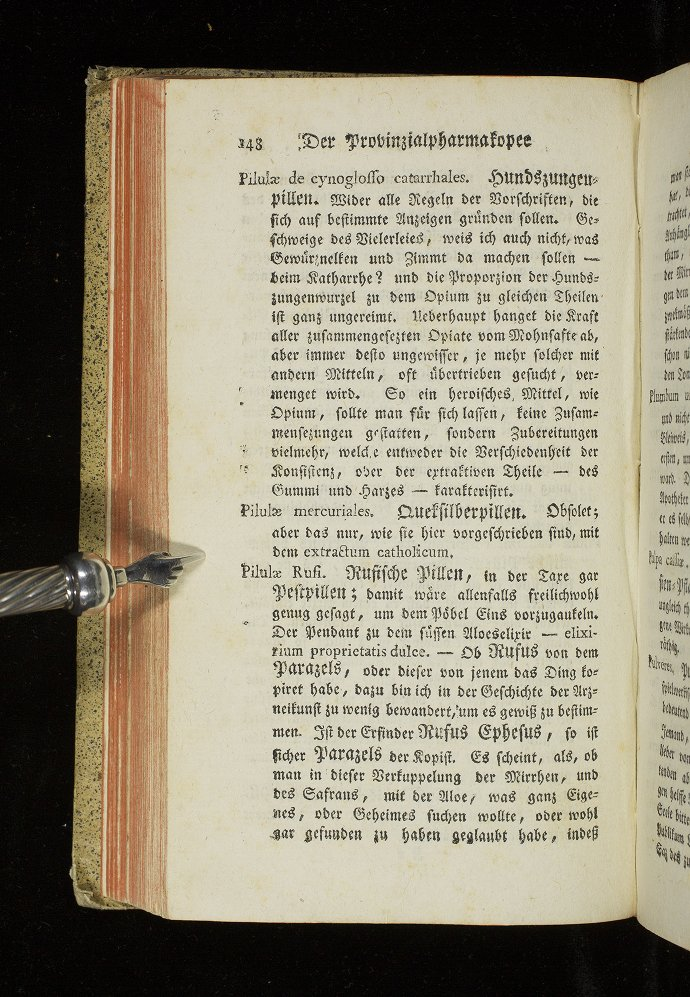

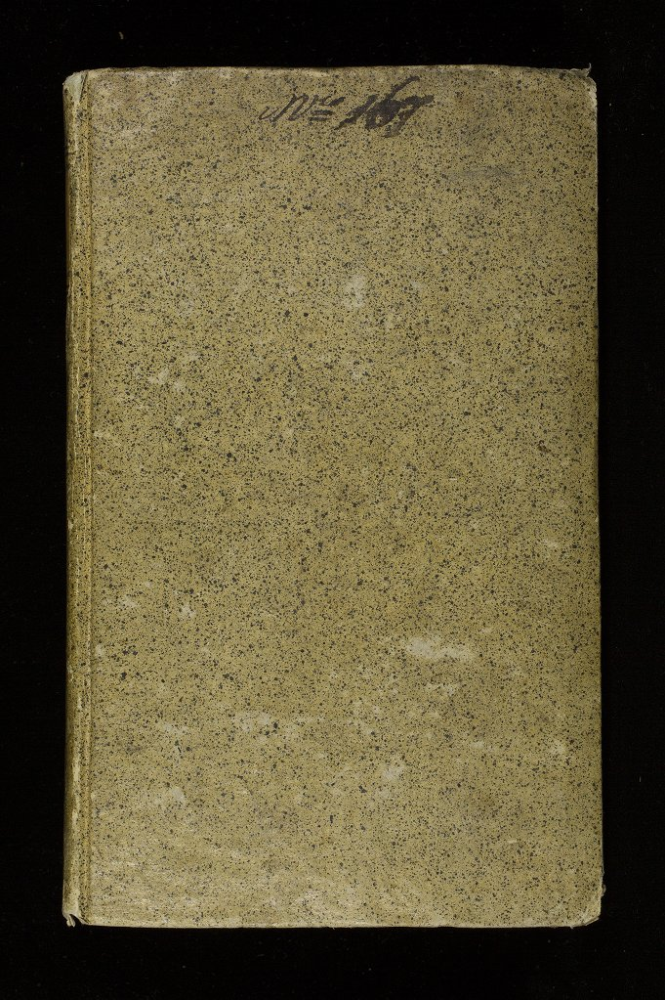

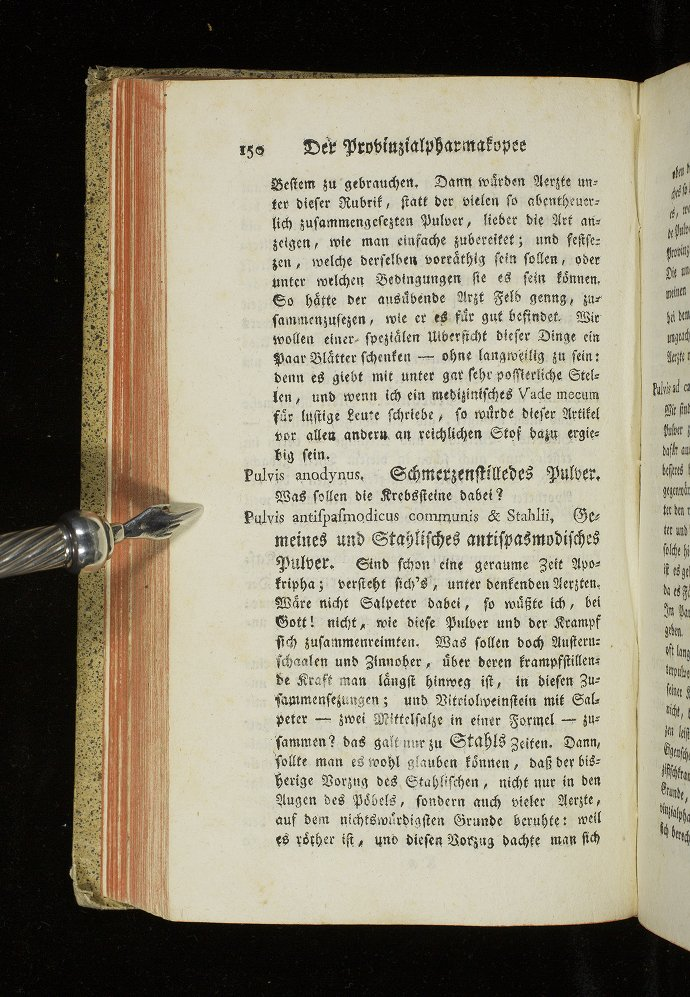

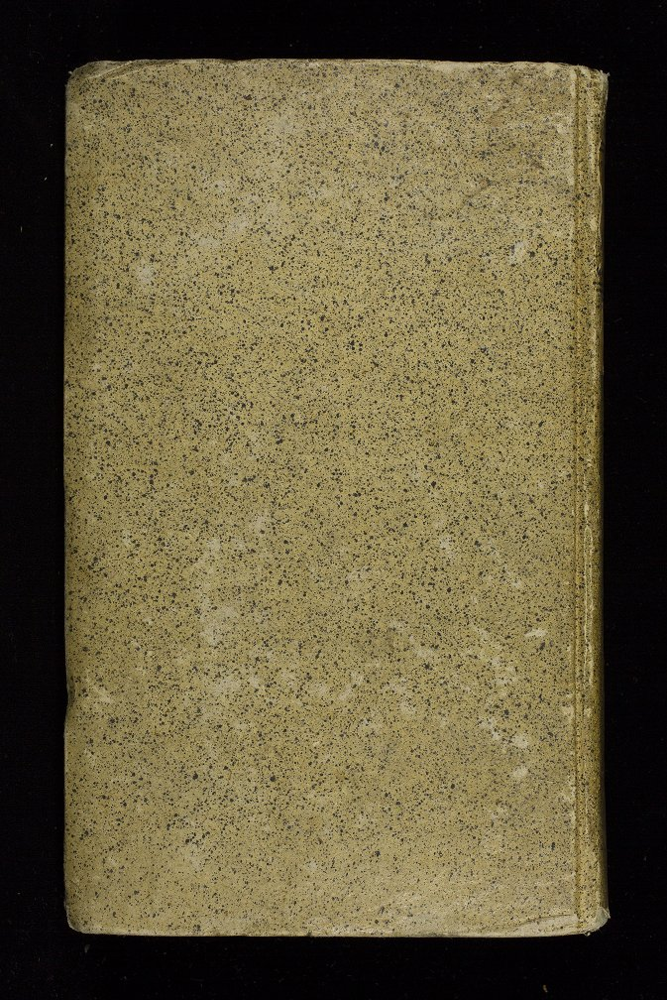

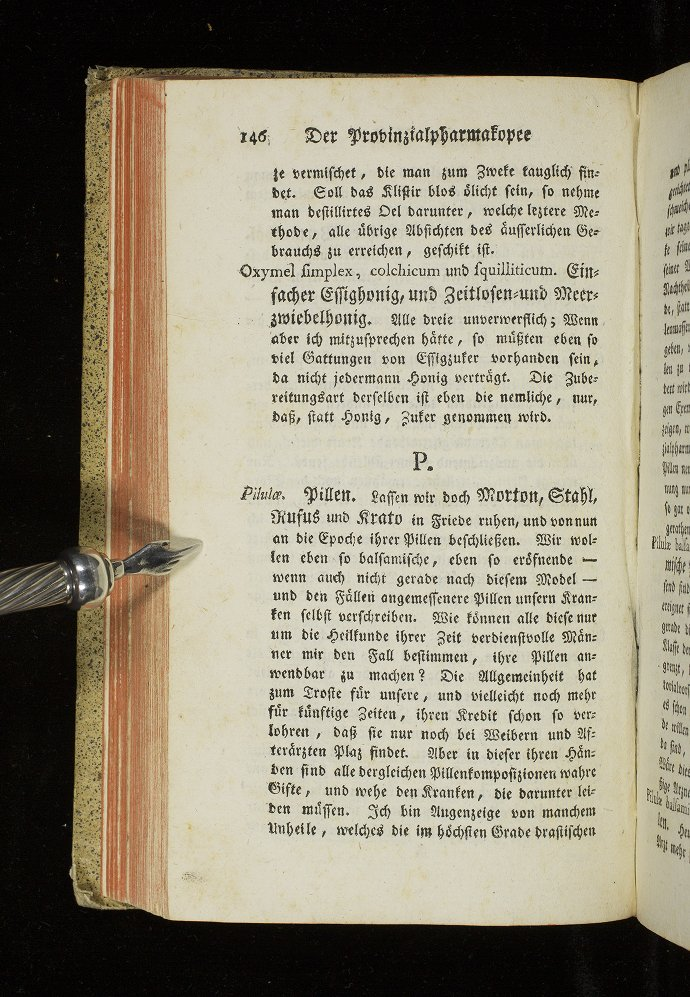

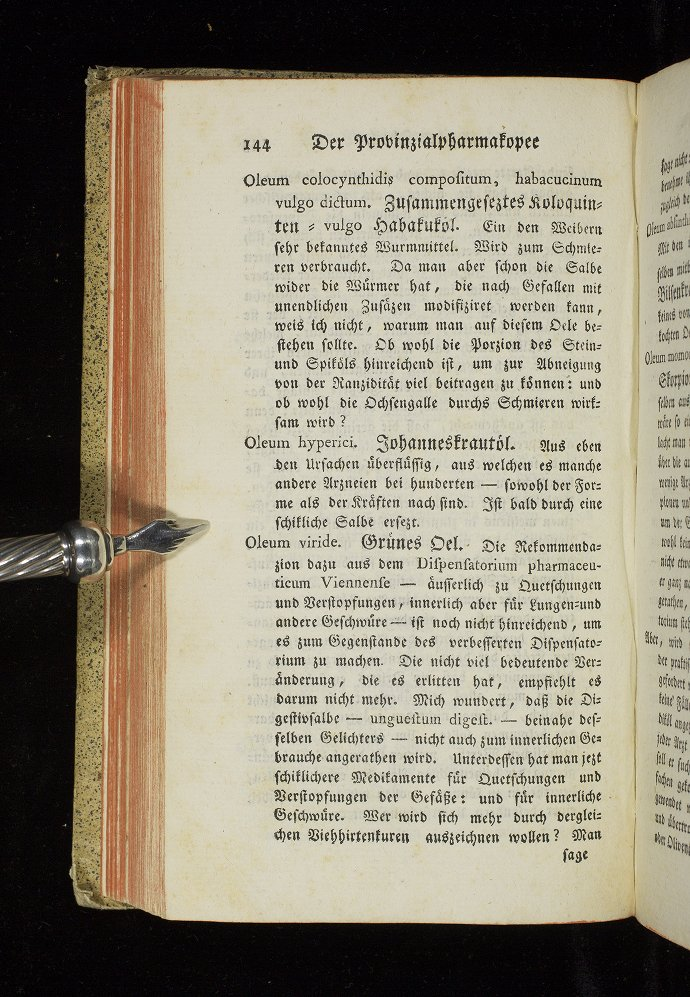

The Chronology of Ancient Kingdoms Amended -- Dilation: 5 Erosion: 8
3 missing images
61 extra images
413 total pages
Missing:


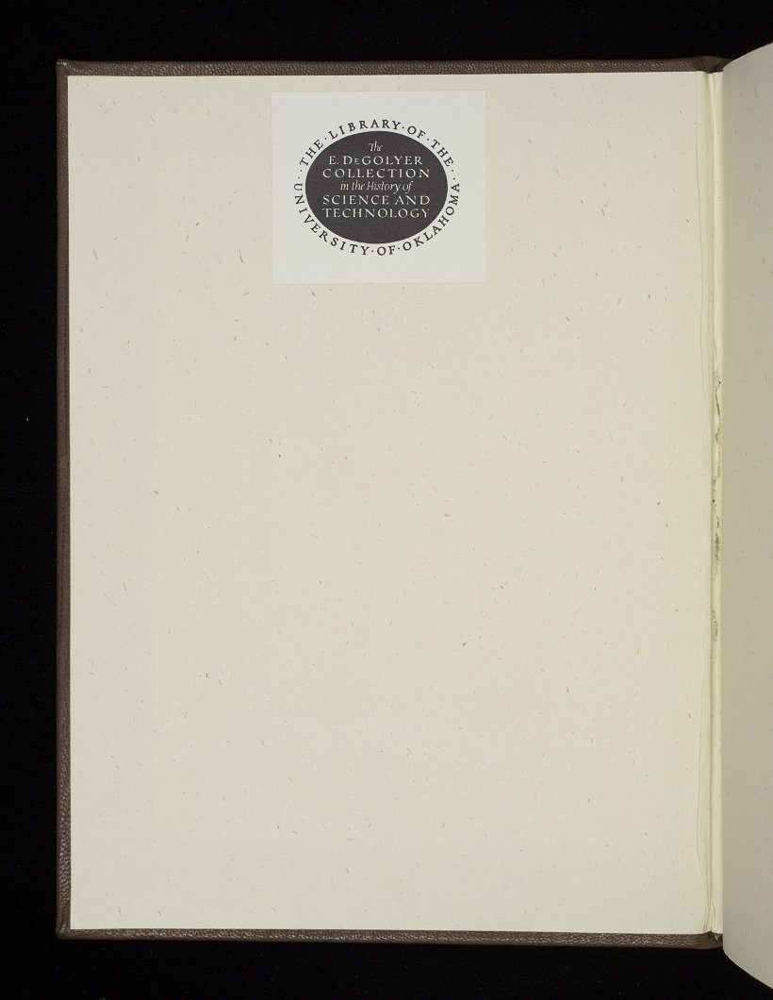

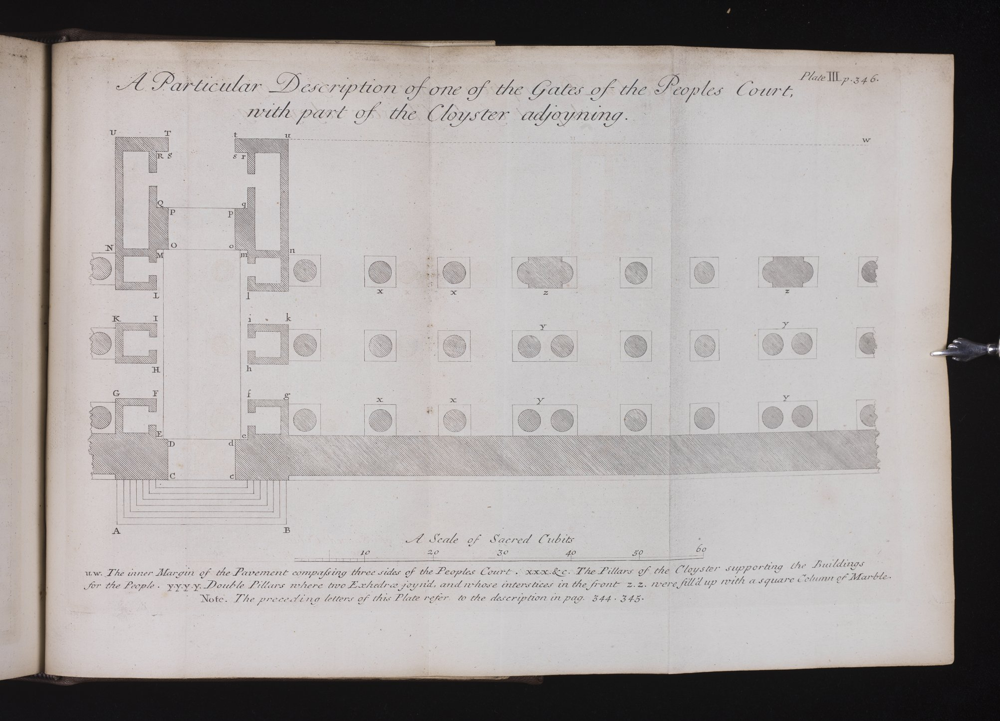

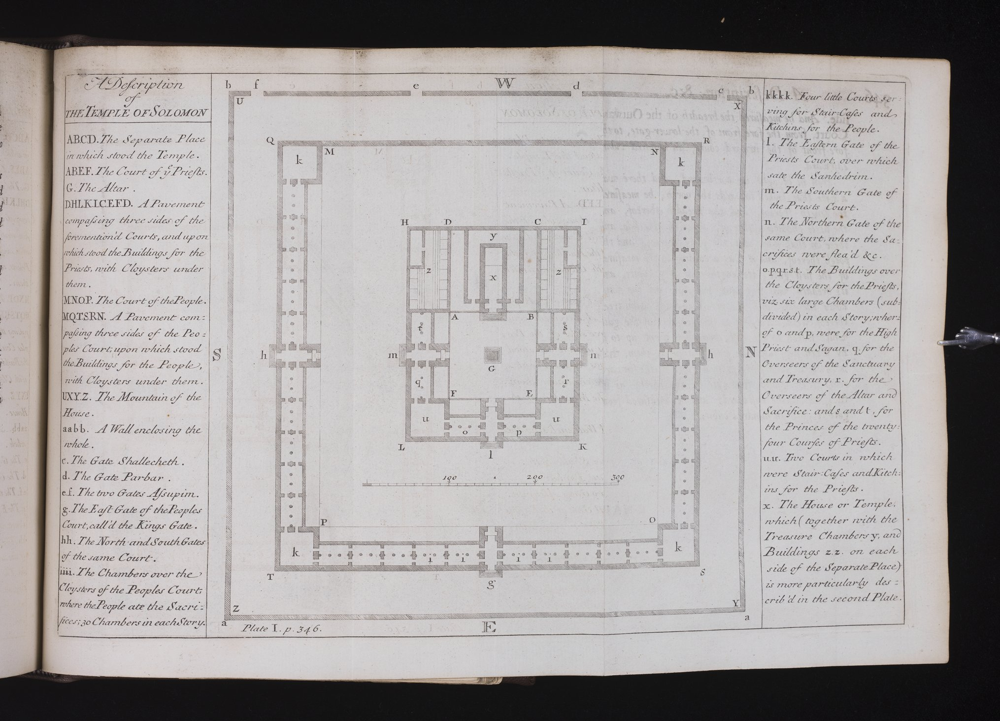

De furtivis literarum notis vulgo -- Dilation: 1 Erosion: 19
22 missing images
30 extra images
259 total pages
Missing:


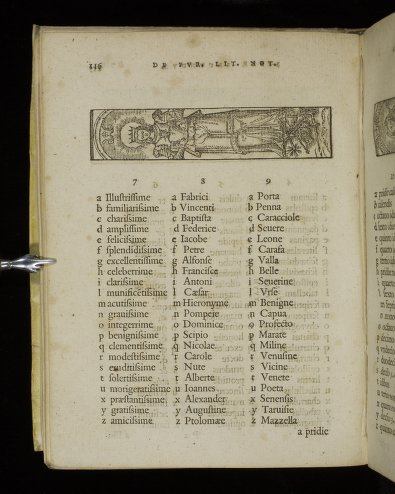

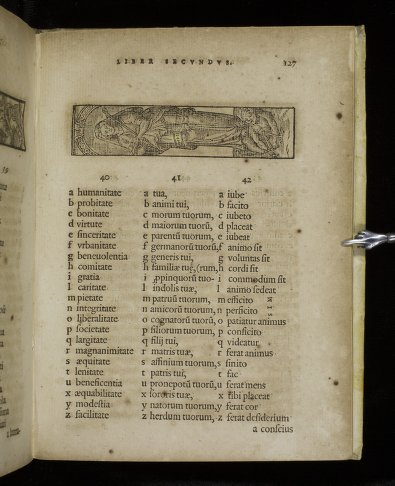

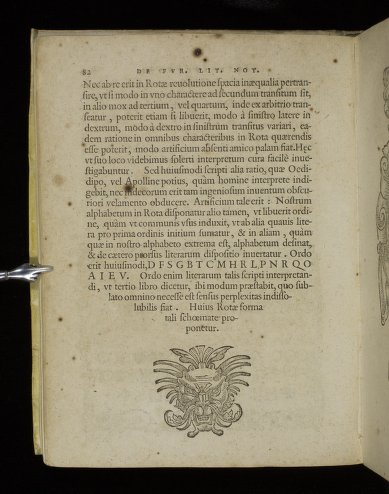

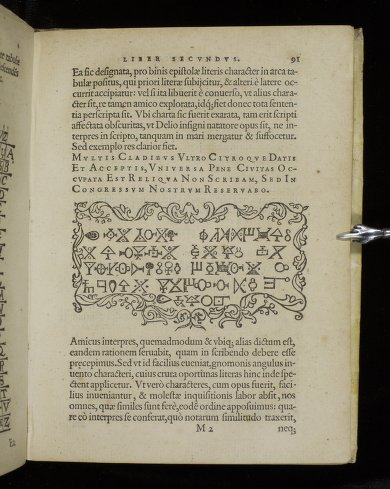

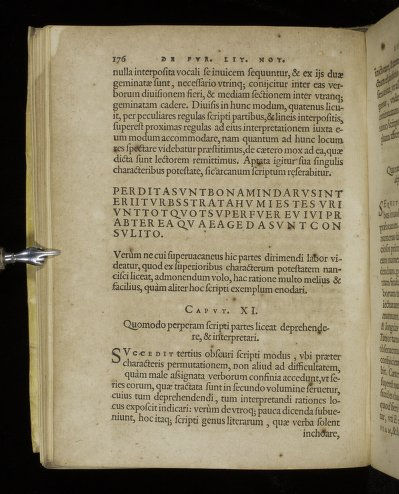

...

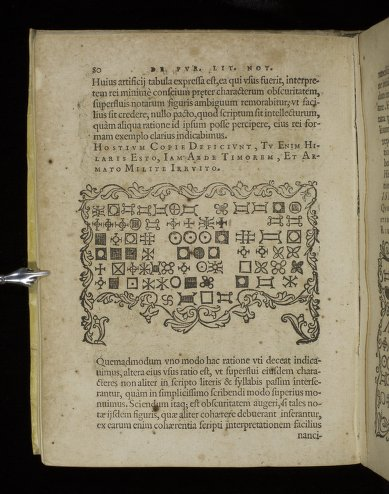

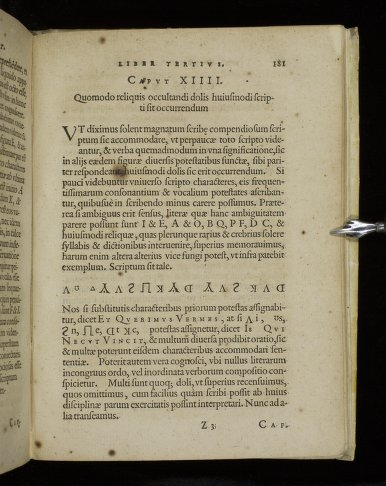

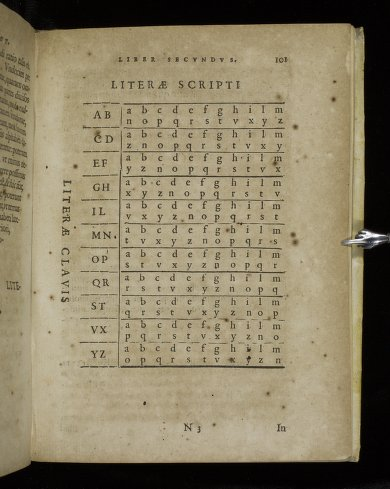

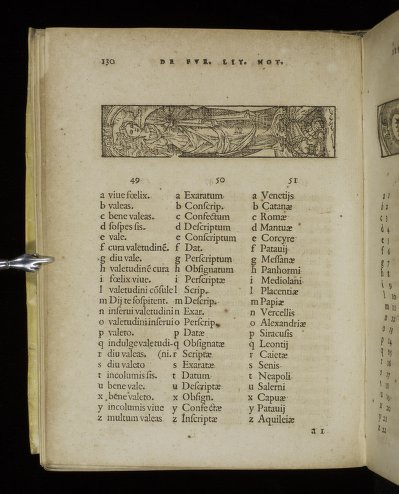

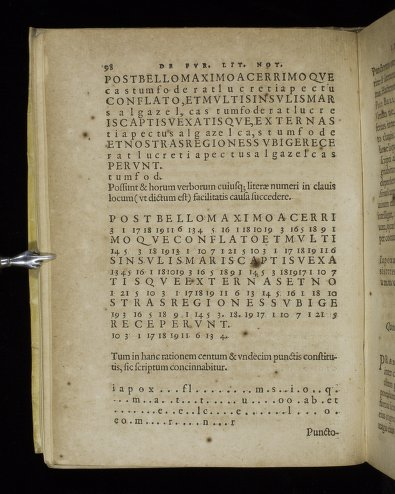

Sopra il turbine -- Dilation: 1 Erosion: 8
0 missing images
29 extra images
203 total pages
Missing:
Extras:


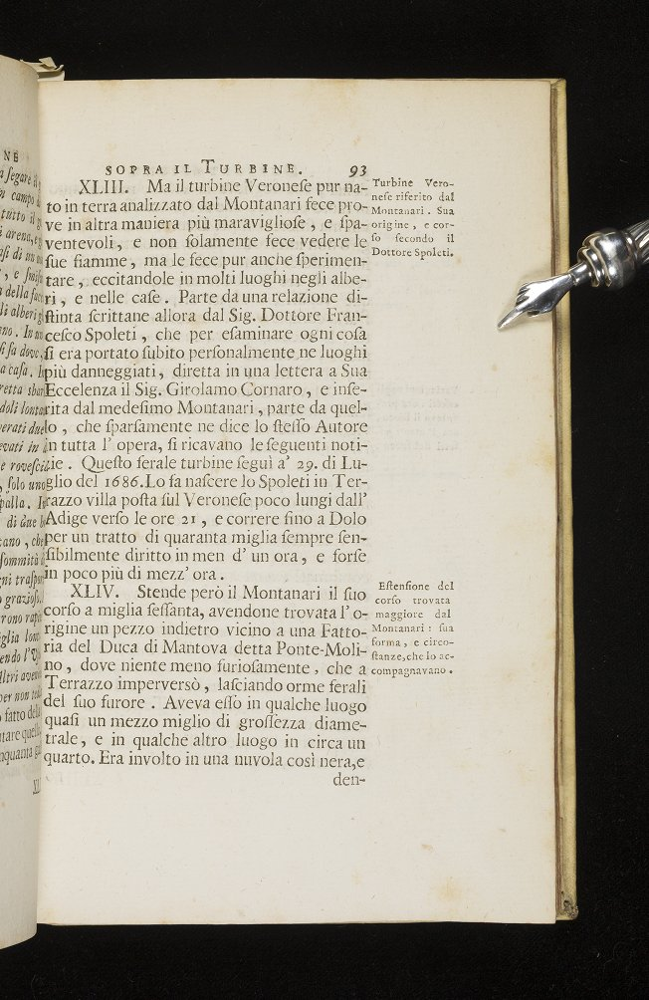

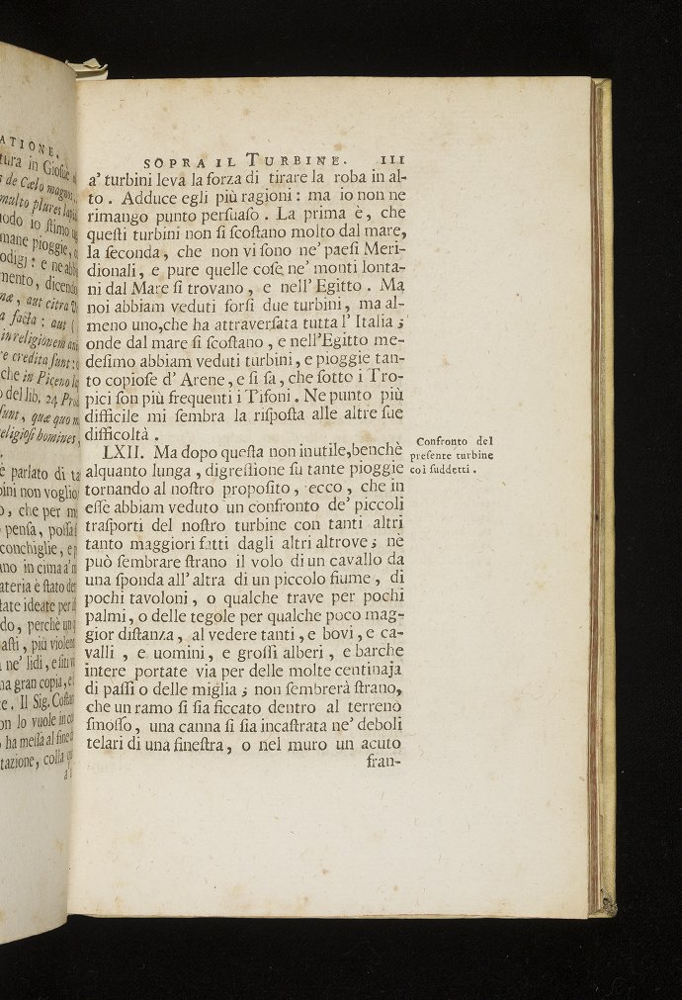

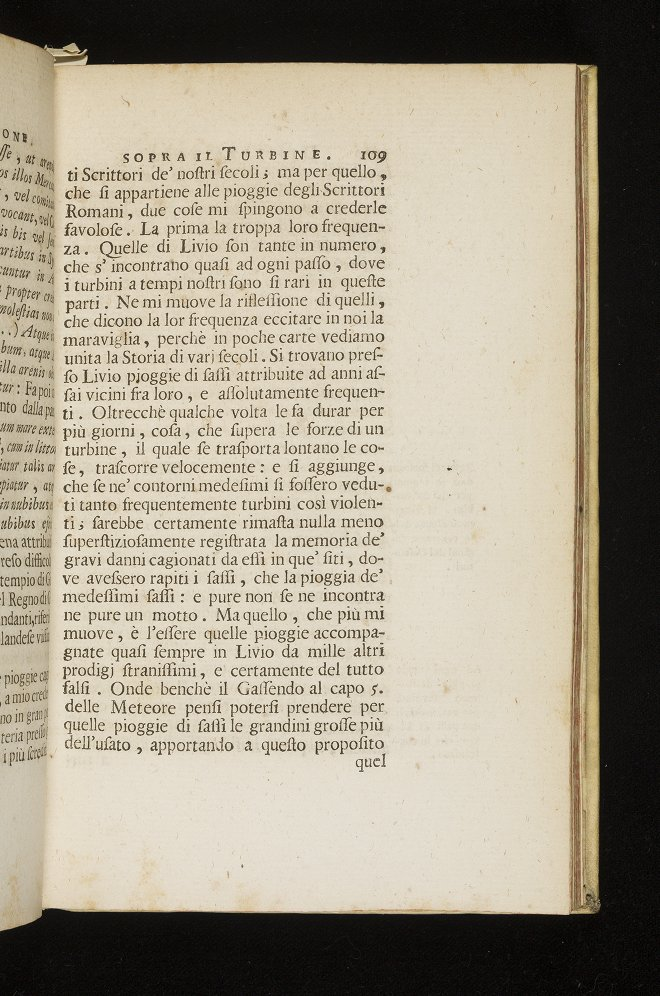

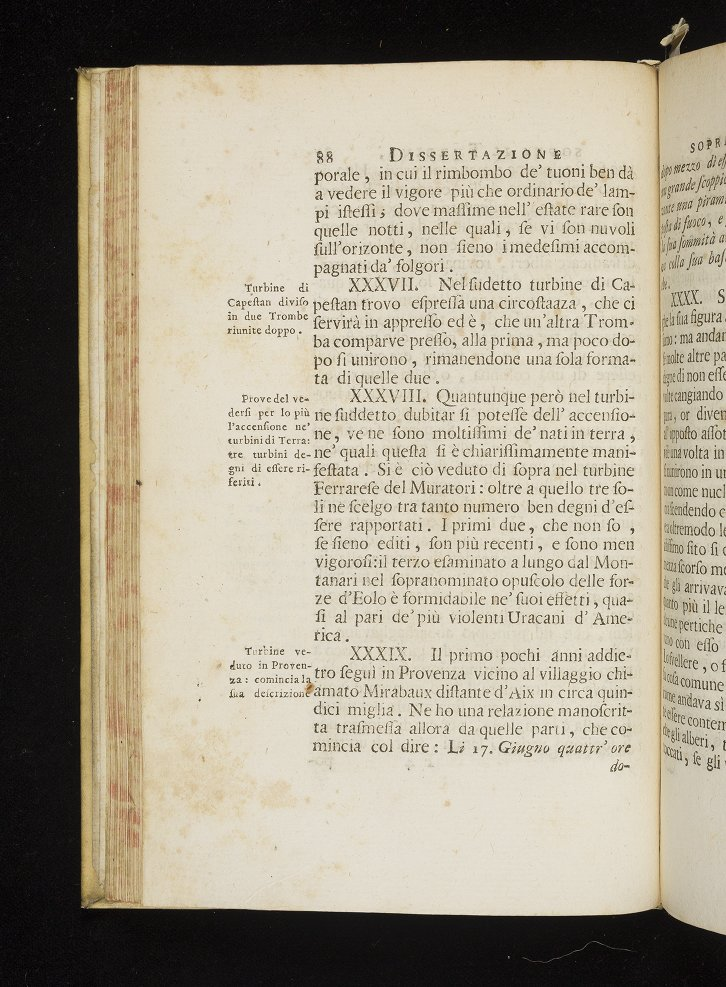

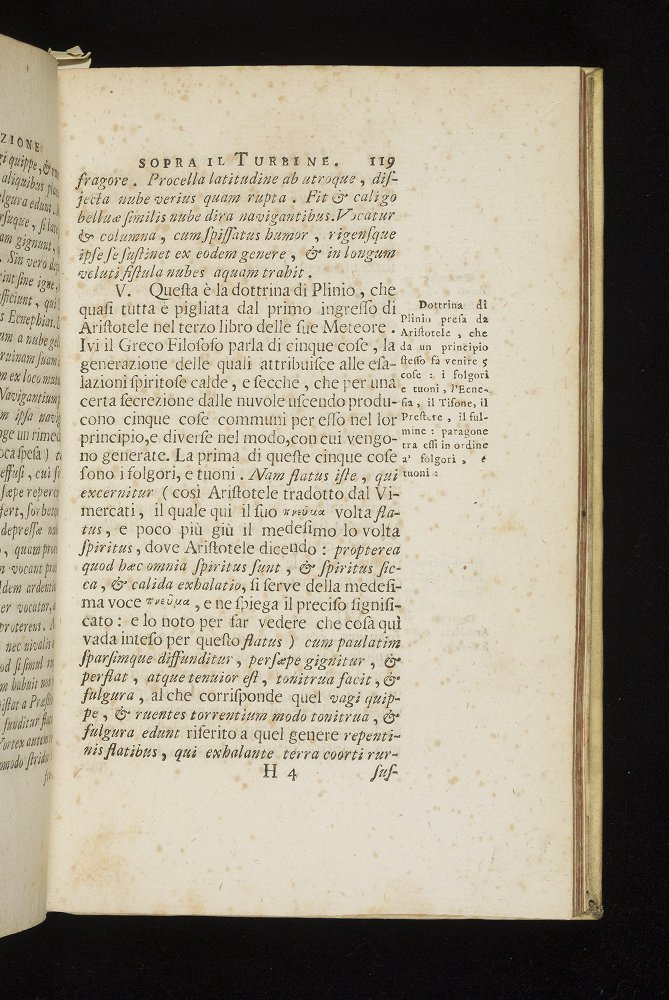

...

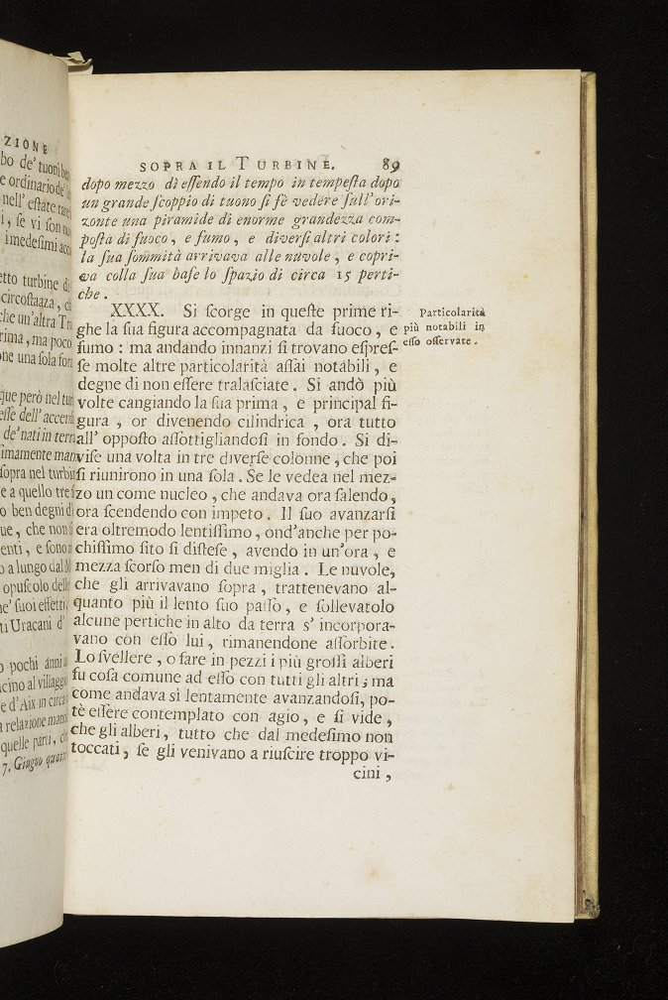

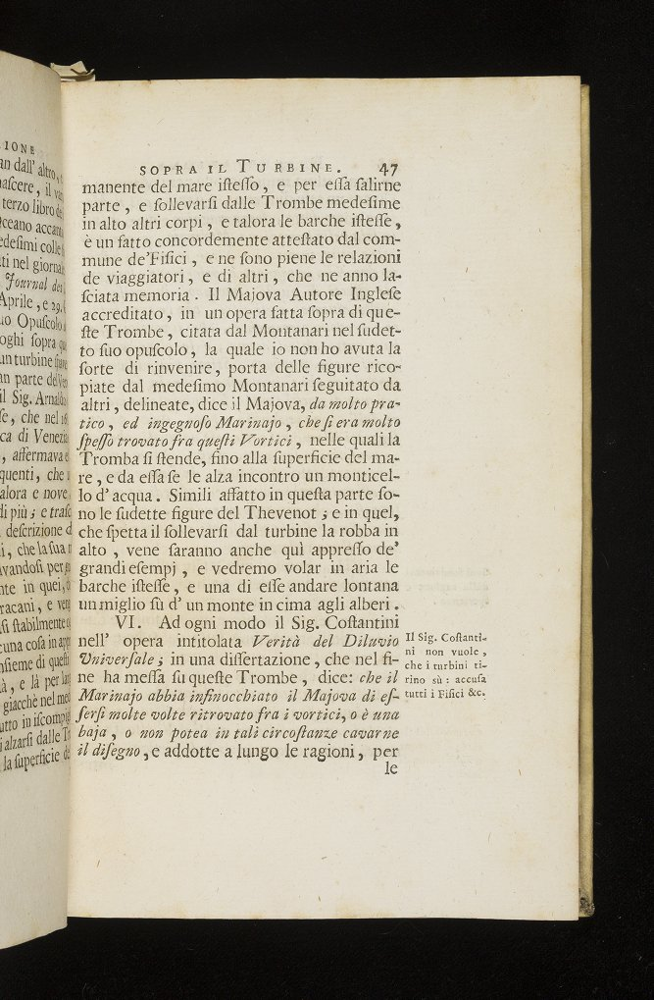

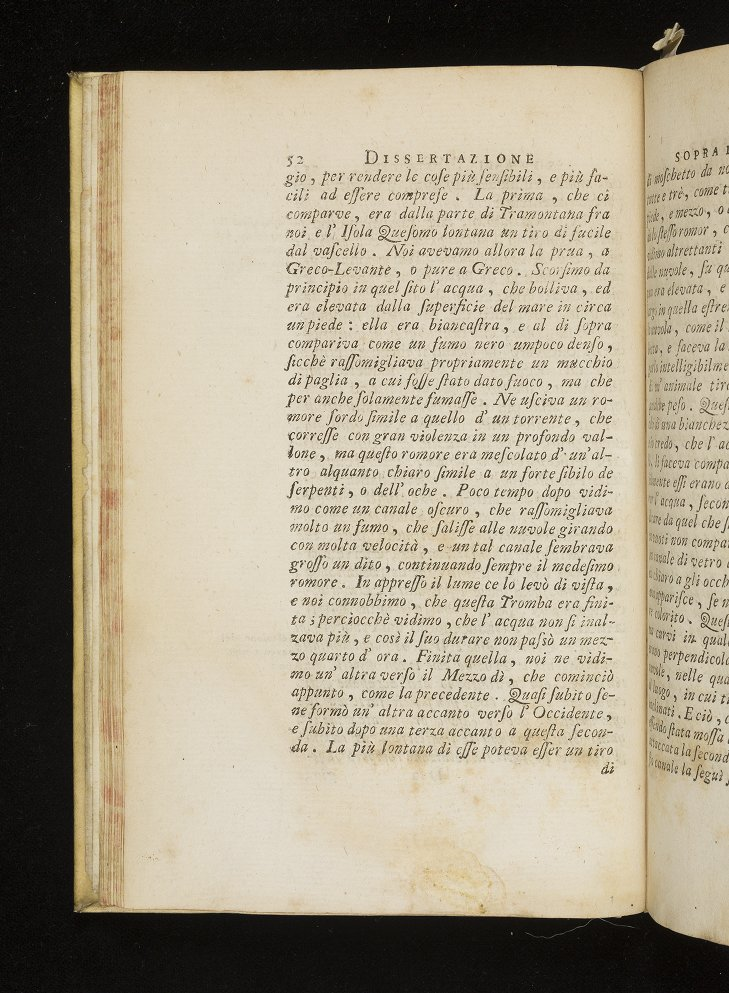

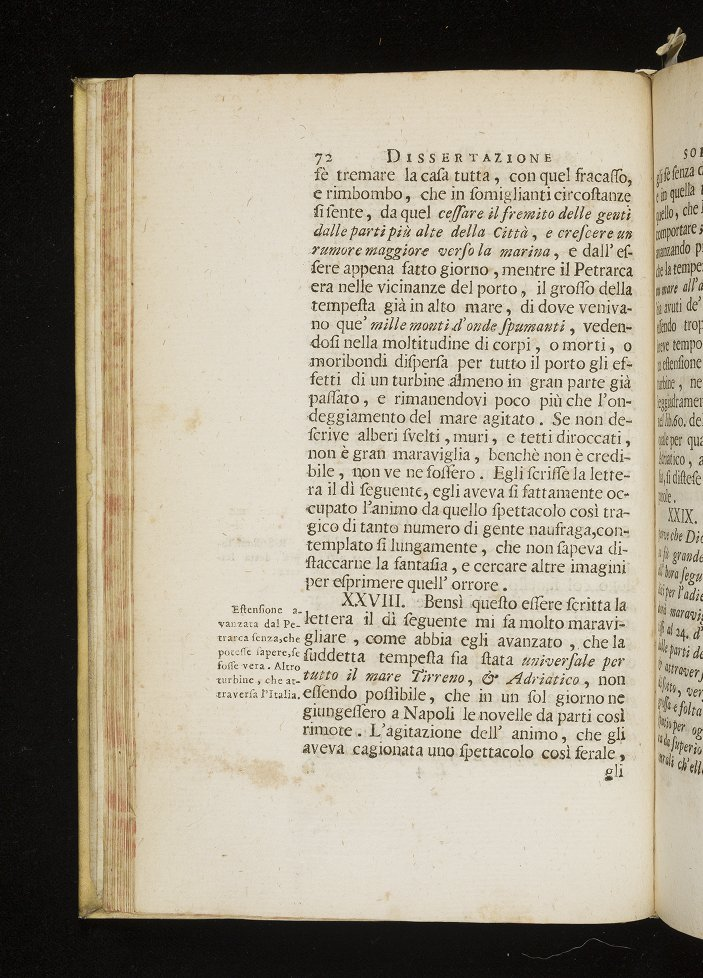

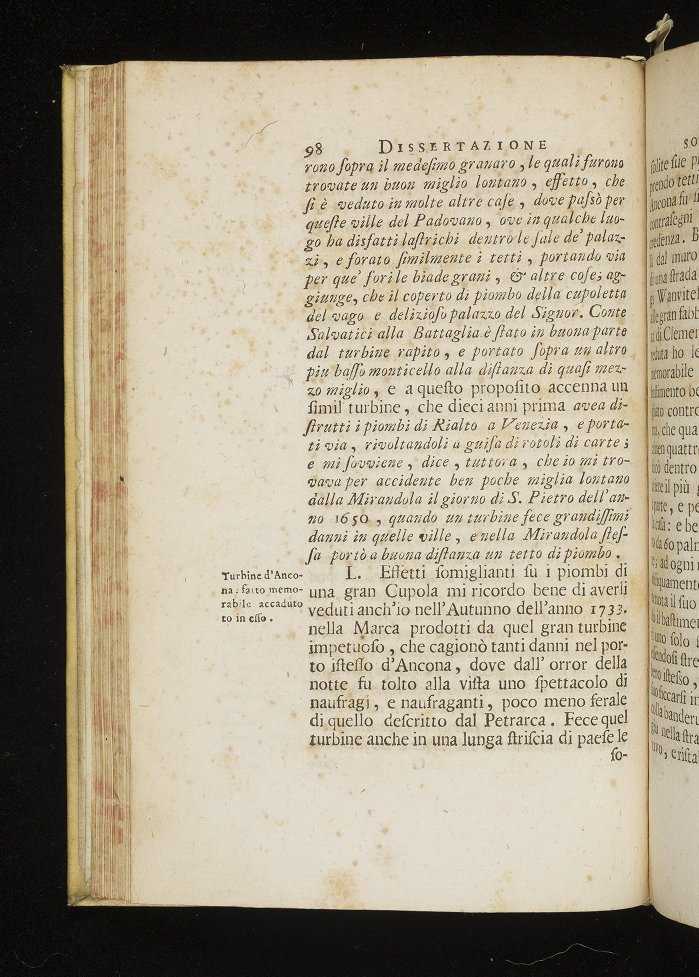

General History of China Volume 2 -- Dilation: 5 Erosion: 18
	Merging overlapping extracts: (478, 673)-(671, 972) (216, 99)-(683, 694)
	Merging overlapping extracts: (98, 531)-(433, 813) (321, 336)-(491, 833)
	Merging overlapping extracts: (90, 131)-(469, 296) (88, 255)-(466, 372)
	Merging overlapping extracts: (103, 119)-(295, 816) (119, 82)-(469, 191)
	Merging overlapping extracts: (393, 421)-(673, 681) (211, 108)-(668, 703)
	Merging overlapping extracts: (244, 396)-(450, 758) (241, 94)-(702, 468)
	Merging overlapping extracts: (321, 249)-(600, 681) (189, 91)-(600, 277)
	Merging overlapping extracts: (144, 129)-(893, 454) (143, 426)-(896, 748)
	Merging overlapping extracts: (263, 248)-(391, 887) (263, 93)-(726, 402)
	Merging overlapping extracts: (207, 318)-(619, 862) (298, 89)-(642, 329)
	Merging overlapping extracts: (407, 322)-(657, 833) (367, 95)-(656, 323)
	Merging overlapping extracts: (309, 338)-(612, 650) (186, 92)-(617, 367)
	Merging overlapping extracts: (219, 323)-(674, 64

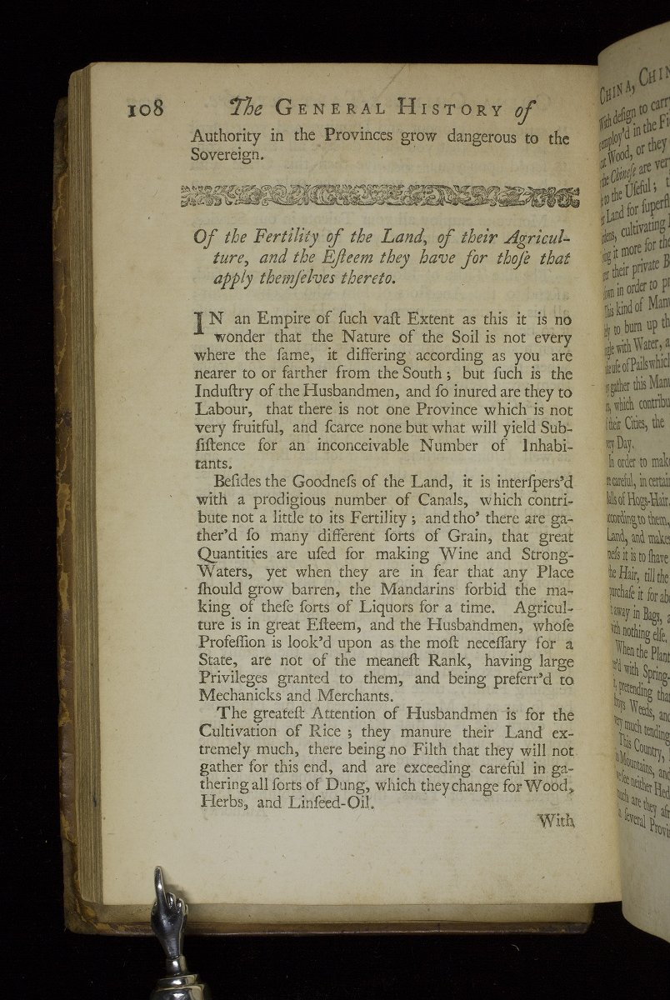

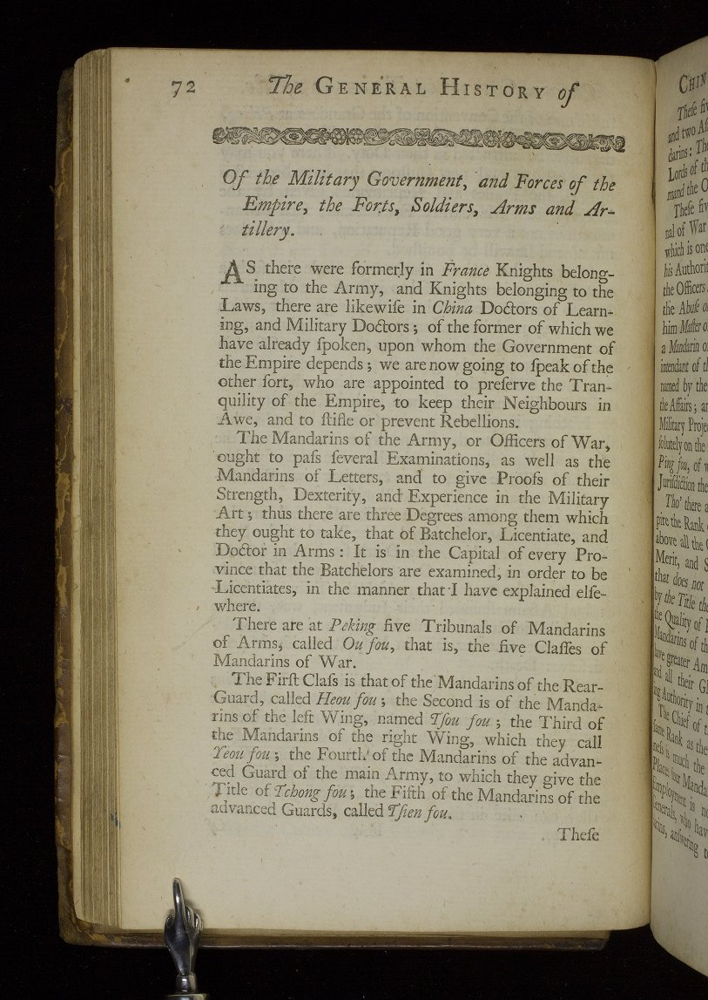

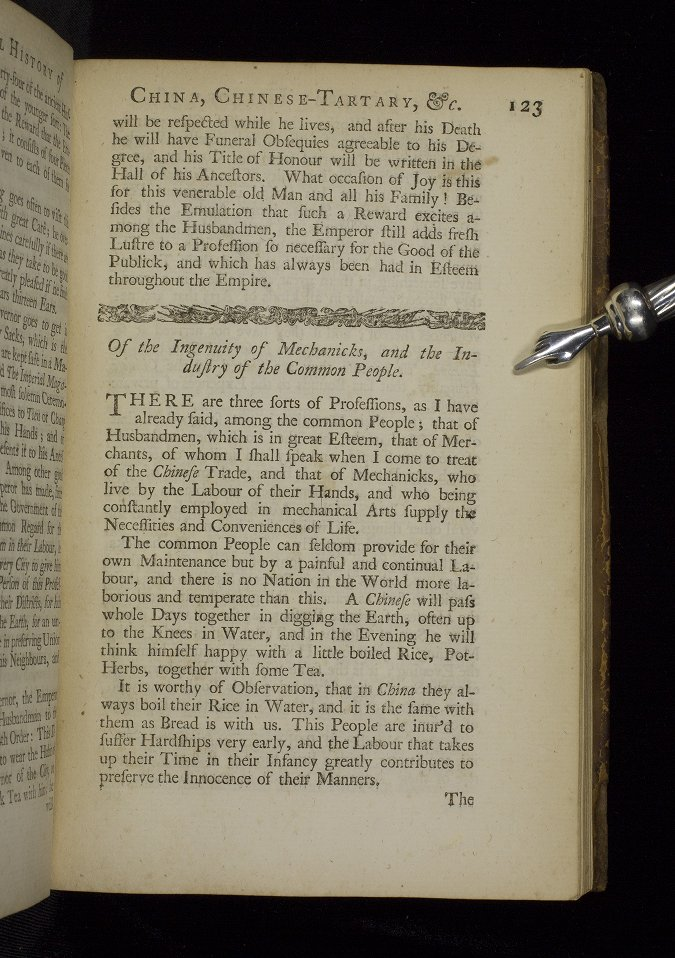

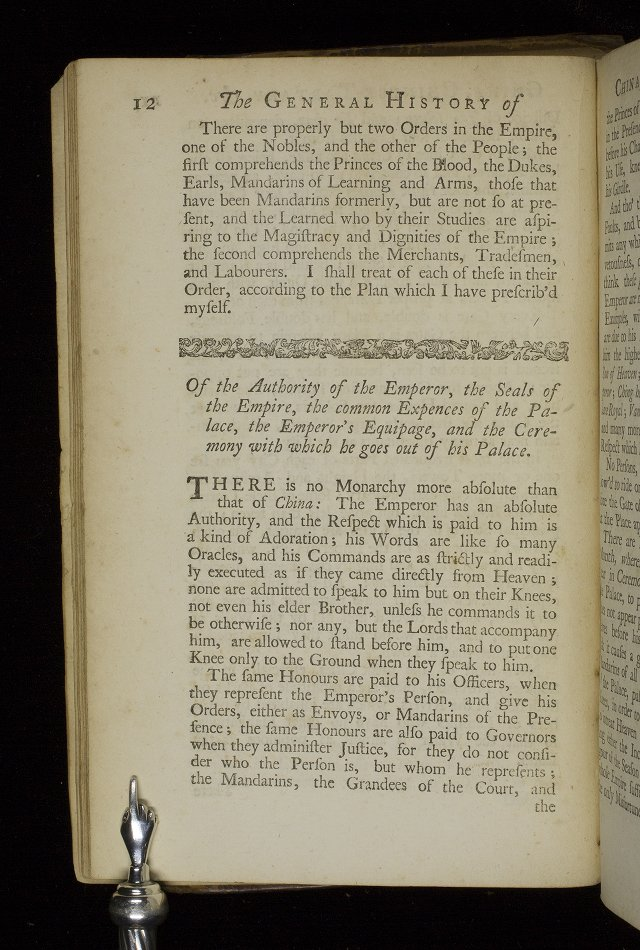

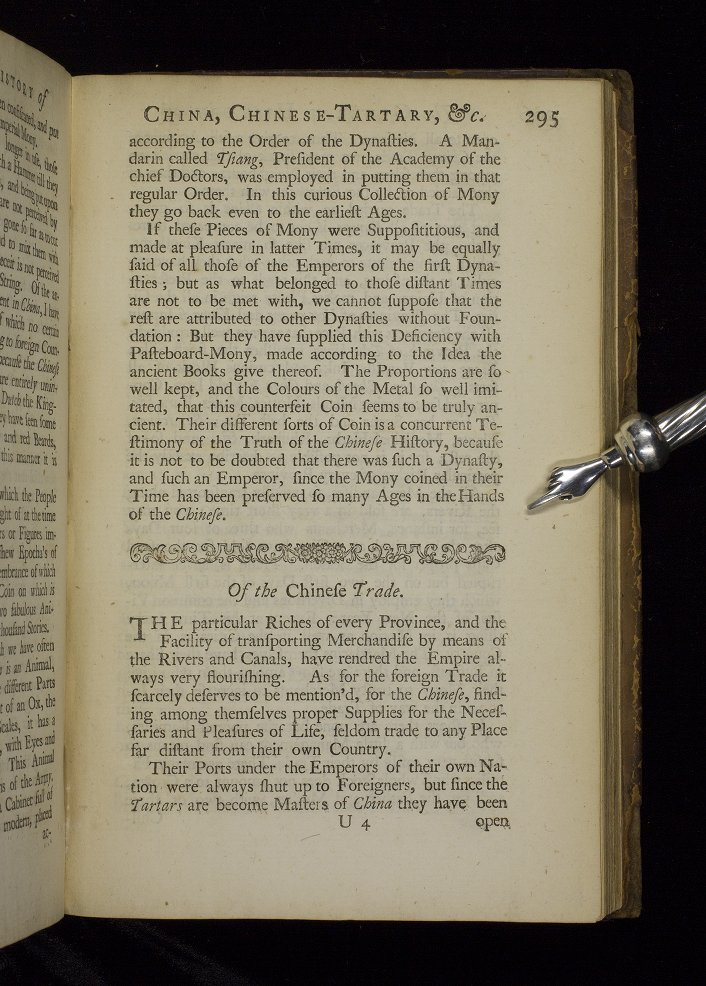

In [261]:
beta = 4
print( "Beta: " + str(beta) )
for book in books:
    title = book.name
    missing, extras = getMissingExtraction(book, books_recall[title], books_precision[title], beta )
    print(str(len(missing)) + " missing images")
    print(str(len(extras)) + " extra images")
    print(str(len(book.files)) + " total pages")

    if len(missing) < 30:
        print("Missing:")
        for img in missing:
            missing_img = book.dir + "/3/" + img
            display(Image(filename = missing_img, width=200, height=200))
        
    if len(extras) < 30:
        print("Extras:")
        for img in extras:
            missing_img = book.dir + "/3/" + img
            display(Image(filename = missing_img, width=200, height=200))

In [367]:
from PIL import Image as PImage
import math

books_param_data = []

beta = 2.5

for book in books:
    book_precision = books_precision[book.name]
    book_recall = books_recall[book.name]
    f2 = (1 + beta * beta) * ( (book_recall * book_precision) / (beta * beta * book_precision + book_recall) )
    f2_max = f2.idxmax()
    f2_maxval = f2.max()
    
    maxs = f2_maxval[ f2_maxval == f2_maxval.max() ].index
    
    dilation_size = max( list( maxs ) )
    erosion_size = f2_max[dilation_size]
    
    
    file = book.dir + "/3/" + book.files[0] 
    img = PImage.open(file)
    size = math.log(img.size[0]*img.size[1])
#     size = math.sqrt(img.size[0]*img.size[1])
    
    books_param_data.append( (size, erosion_size, dilation_size) )

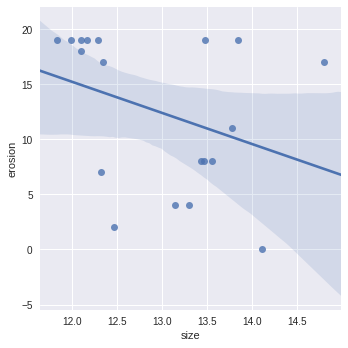

In [368]:
sns.lmplot(data=paramdf, x="size", y="erosion")

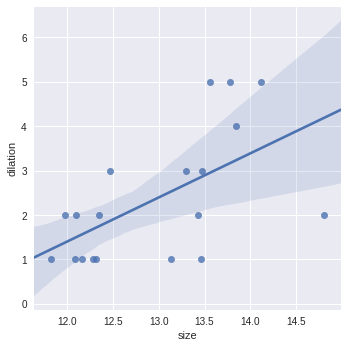

In [313]:
sns.lmplot(data=paramdf, x="size", y="dilation")

In [321]:
paramdf["size"]

0     11.982679
1     13.471284
2     12.101112
3     13.137220
4     14.113301
5     14.801078
6     11.828181
7     13.839454
8     12.343637
9     13.427964
10    12.465000
11    12.092153
12    12.316271
13    12.283561
14    13.297291
15    13.558464
16    12.166115
17    13.464913
18    13.779676
Name: size, dtype: float64

In [323]:
paramdf["erosion"]

0     19
1     19
2     18
3      4
4      0
5     17
6     19
7     19
8     17
9      8
10     2
11    19
12     7
13    19
14     4
15     8
16    19
17     8
18    11
Name: erosion, dtype: int64

In [356]:
from sklearn import linear_model

lm_erosion = linear_model.LinearRegression()
lm_erosion.fit(paramdf["size"].values.reshape(-1,1), paramdf["erosion"].values.reshape(-1,1))
# erosion_predict = lm_erosion.predict((paramdf["size"].values.reshape(-1,1)))

lm_dilation = linear_model.LinearRegression()
lm_dilation.fit(paramdf["size"].values.reshape(-1,1), paramdf["dilation"].values.reshape(-1,1))
# dilation_predict = lm_dilation.predict((paramdf["size"].values.reshape(-1,1)))



for i, book in enumerate(books):
    book_precision = books_precision[book.name]
    book_recall = books_recall[book.name]
    f2 = (1 + beta * beta) * ( (book_recall * book_precision) / (beta * beta * book_precision + book_recall) )
    f2_max = f2.idxmax()
    f2_maxval = f2.max()
    
    maxs = f2_maxval[ f2_maxval == f2_maxval.max() ].index
    
    dilation_size = max( list( maxs ) )
    erosion_size = f2_max[dilation_size]
    
    file = book.dir + "/3/" + book.files[0] 
    img = PImage.open(file)
#     size = math.sqrt(img.size[0]*img.size[1])
    size = math.log(img.size[0]*img.size[1])
    
#     lm_erosion.predict(size)
    
    er_pred =  int( lm_erosion.predict(size)[0][0] )
    dil_pred = int( lm_dilation.predict(size)[0][0] )
    print(book.name)
    print(img.size)
    print()
    print( str(erosion_size) + ", " + str(dilation_size) )
    print( str( er_pred ) + ", " + str( dil_pred ) )
    print()
    print(books_recall[book.name][dil_pred][er_pred])
    print(books_recall[book.name][dilation_size][erosion_size])
    print()
    print("--------------")

The First Six Books of Euclid in which Colored Diagrams and Symbols are used instead of Letters for the greater ease of Learners
(372, 430)

19, 2
15, 1

0.992537313433
1.0

--------------
Opera
(736, 963)

19, 3
11, 2

0.384615384615
0.923076923077

--------------
The history of fourfooted beasts and serpents
(369, 488)

18, 2
14, 1

0.726907630522
0.907630522088

--------------
Theory of the Earth
(578, 878)

4, 1
12, 2

0.85
0.5

--------------
Atlas coelestis
(1403, 960)

0, 5
9, 3

1.0
1.0

--------------
The Natural History of Human Teeth
(1453, 1844)

17, 2
7, 4

0.4375
0.8125

--------------
Harmonices mvndi
(291, 471)

19, 1
15, 1

0.375
0.75

--------------
Perspectiva
(904, 1133)

19, 4
10, 3

0.535714285714
1.0

--------------
The Systeme of the World in Four Dialogues in Thomas Salusbury Mathematical Discourses 1661
(395, 581)

17, 2
14, 1

0.529411764706
0.647058823529

--------------
Discorso delle comete di mario Gvidvcci...
(707, 960)

8, 2
11, 2

0.833333333333
0.8333

In [360]:
lm_erosion.score(paramdf["size"].values.reshape(-1,1), paramdf["erosion"].values.reshape(-1,1))

0.12136429269450665

In [361]:
lm_erosion.coef_

array([[-2.82356956]])

In [362]:
lm_erosion.intercept_

array([ 49.1012299])

In [363]:
lm_dilation.coef_

array([[ 0.99387826]])

In [364]:
lm_dilation.intercept_

array([-10.52423863])